## Preparation

##### Import Functions

In [1]:
from Class.Helper import Helper as Helper
from Scripts.LoadCSV import LoadCSV as LoadCSV
from Scripts.Fuzzify import Fuzzify as Fuzzify
from Scripts.ValueTest import ValueTest as ValueTest
from Scripts.OptimizeBruteForce import OptimizeBruteForce as OptimizeBruteForce
from Scripts.OptimizeBruteForceKFold import OptimizeBruteForceKFold as OptimizeBruteForceKFold
import warnings
warnings.simplefilter("ignore")

In [7]:
fuzzify = Fuzzify()
changed_decisions, features_number_after_reduct, implicants_number, fuzzify_parameters = fuzzify.worker(settings, settings.adjustment_value)            

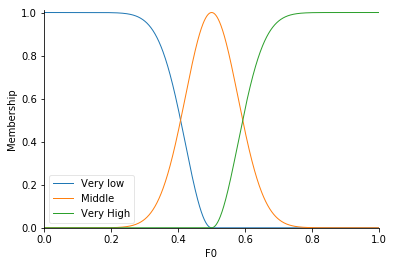

In [10]:
df[0].view()

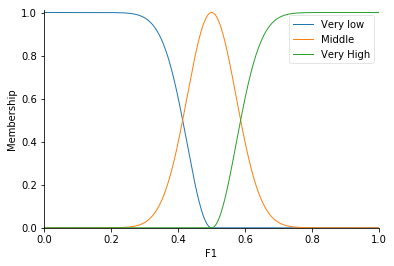

In [11]:
df[1].view()

In [12]:
import pickle
df = pickle.load(open(settings.backup_folder + "features.p", "rb"))
d = pickle.load(open(settings.backup_folder + "train_features_df.p", "rb"))

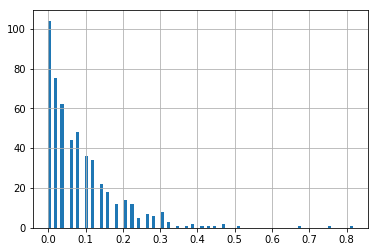

In [15]:
d["F1"].hist(bins=100)

In [5]:
settings.class_2

'Donated'

In [6]:
df.loc[df.index == 627]

,F0,F1,F2,F3,Decision,Image
627,0.148649,0.020408,0.020408,0.09375,Not,


## Experiment 1 -- Gauss Number & Gauss Style & Gauss Adjustment

In [4]:
import Settings.GeneralSettings as generalSettings
from Settings.SettingsBlood import Settings as Settings

helper = Helper()

for gauss in [5, 7, 9, 11]:
    for style in ["Gaussian Progressive", "Gaussian Equal"]:
        for adjustment in [-2]:
            generalSettings.gausses = gauss
            generalSettings.style = style
            generalSettings.adjustment_value = adjustment
            settings = Settings(generalSettings)        

            loadCSV = LoadCSV()
            samples_stats, train_stats, test_stats, train_samples = loadCSV.worker(settings)
            
            fuzzify = Fuzzify()
            changed_decisions, features_number_after_reduct, implicants_number, fuzzify_parameters = fuzzify.worker(settings, settings.adjustment_value)
            
            fuzzification_data = [settings.dataset_name, settings.style, settings.gausses, settings.adjustment, samples_stats, train_stats, test_stats, changed_decisions, round(changed_decisions / train_samples, 2), implicants_number, settings.feature_numbers, features_number_after_reduct]
            helper.saveFuzzificationStats(fuzzification_data)

            valueTest = ValueTest(settings, settings.s_function_width, settings.is_training)
            valueTest.sOptymalizationWorker(settings, settings.default_s_value, settings.show_results)

            valueTest = ValueTest(settings, settings.s_function_width, not settings.is_training)
            valueTest.sOptymalizationWorker(settings, settings.default_s_value, settings.show_results)

Gaussian Progressive


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
7,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
8,Blood,Gaussian Progressive,9,Mean,748 (570/178),493 (376/117),255 (194/61),348,0.71,145,4,3
9,Blood,Gaussian Equal,9,Mean,748 (570/178),493 (376/117),255 (194/61),271,0.55,222,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.24746450304259635
Precision: [0.2397541 1.       ]
Recall: [1.         0.01329787]
F-Score: [0.38677686 0.02624672]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.25098039215686274
Precision: [0.24206349 1.        ]
Recall: [1.         0.01546392]
F-Score: [0.38977636 0.03045685]
Support: [ 61 194]
Gaussian Equal


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,9,Mean,748 (570/178),493 (376/117),255 (194/61),348,0.71,145,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.3286004056795132
Precision: [0.26008969 0.9787234 ]
Recall: [0.99145299 0.12234043]
F-Score: [0.41207815 0.21749409]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.2980392156862745
Precision: [0.25210084 0.94117647]
Recall: [0.98360656 0.08247423]
F-Score: [0.40133779 0.15165877]
Support: [ 61 194]
Gaussian Progressive


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,7,Optymalized,748 (570/178),493 (376/117),255 (194/61),462,0.94,31,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.768762677484787
Precision: [1.         0.76734694]
Recall: [0.02564103 1.        ]
F-Score: [0.05       0.86836028]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.7686274509803922
Precision: [0.75      0.7689243]
Recall: [0.04918033 0.99484536]
F-Score: [0.09230769 0.86741573]
Support: [ 61 194]
Gaussian Equal


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,7,Optymalized,748 (570/178),493 (376/117),255 (194/61),462,0.94,31,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.7748478701825557
Precision: [1.         0.77207392]
Recall: [0.05128205 1.        ]
F-Score: [0.09756098 0.87137891]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.7725490196078432
Precision: [0.8   0.772]
Recall: [0.06557377 0.99484536]
F-Score: [0.12121212 0.86936937]
Support: [ 61 194]
Gaussian Progressive


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,7,Optymalized,748 (570/178),493 (376/117),255 (194/61),462,0.94,31,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.7768762677484787
Precision: [1.         0.77366255]
Recall: [0.05982906 1.        ]
F-Score: [0.11290323 0.87238979]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.7725490196078432
Precision: [0.8   0.772]
Recall: [0.06557377 0.99484536]
F-Score: [0.12121212 0.86936937]
Support: [ 61 194]
Gaussian Equal


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,7,Optymalized,748 (570/178),493 (376/117),255 (194/61),462,0.94,31,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.7768762677484787
Precision: [1.         0.77366255]
Recall: [0.05982906 1.        ]
F-Score: [0.11290323 0.87238979]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.7647058823529411
Precision: [0.6   0.768]
Recall: [0.04918033 0.98969072]
F-Score: [0.09090909 0.86486486]
Support: [ 61 194]
Gaussian Progressive


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,7,Optymalized,748 (570/178),493 (376/117),255 (194/61),462,0.94,31,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.7768762677484787
Precision: [1.         0.77366255]
Recall: [0.05982906 1.        ]
F-Score: [0.11290323 0.87238979]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.7686274509803922
Precision: [0.66666667 0.77108434]
Recall: [0.06557377 0.98969072]
F-Score: [0.11940299 0.86681716]
Support: [ 61 194]
Gaussian Equal


,Dataset,Style,Gausses,Adjustment,Samples,Train s.,Test s.,Changed s.,% changed s.,Implicants,Features,F. after reduct
0,Blood,Gaussian Progressive,3,Optymalized,748 (570/178),493 (376/117),255 (194/61),485,0.98,8,4,3
1,Blood,Gaussian Progressive,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
2,Blood,Gaussian Equal,3,Mean,748 (570/178),493 (376/117),255 (194/61),475,0.96,18,4,3
3,Blood,Gaussian Progressive,5,Mean,748 (570/178),493 (376/117),255 (194/61),438,0.89,55,4,3
4,Blood,Gaussian Equal,5,Mean,748 (570/178),493 (376/117),255 (194/61),401,0.81,92,4,3
5,Blood,Gaussian Progressive,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),479,0.97,14,4,3
6,Blood,Gaussian Equal,5,Optymalized,748 (570/178),493 (376/117),255 (194/61),468,0.95,25,4,3
7,Blood,Gaussian Progressive,7,Mean,748 (570/178),493 (376/117),255 (194/61),397,0.81,96,4,3
8,Blood,Gaussian Equal,7,Mean,748 (570/178),493 (376/117),255 (194/61),353,0.72,140,4,3
9,Blood,Gaussian Progressive,7,Optymalized,748 (570/178),493 (376/117),255 (194/61),462,0.94,31,4,3


-----------------------------------------------------------------------------------
Accuracy: 0.7931034482758621
Precision: [1.         0.78661088]
Recall: [0.12820513 1.        ]
F-Score: [0.22727273 0.88056206]
Support: [117 376]
-----------------------------------------------------------------------------------
Accuracy: 0.7490196078431373
Precision: [0.33333333 0.76422764]
Recall: [0.04918033 0.96907216]
F-Score: [0.08571429 0.85454545]
Support: [ 61 194]


## Experiment 2 -- S-Function Optymalization

In [ ]:
import Settings.GeneralSettings as generalSettings
from Settings.SettingsBlood import Settings as Settings

helper = Helper()

for gauss in [3, 5, 7, 9, 11]:
    for style in ["Gaussian Progressive", "Gaussian Equal"]:
        for adjustment in [-1, -2]:

            optimizeBruteForceKFold = OptimizeBruteForceKFold(settings, settings.s_function_width)
            valueTest = ValueTest(settings, settings.s_function_width, False)

            best_s_function_center, mean_s_function_center, changed_decisions, features_number_after_reduct, implicants_number = optimizeBruteForceKFold.worker(settings, settings.constraints, settings.s_function_width, settings.n_folds)


            valueTest.sOptymalizationWorker(settings, best_s_function_center, "Test Value - K-Fold - Best Function Center")
            threshold = optimizeBruteForceKFold.thresholdWorker(settings, best_s_function_center, settings.s_function_width)
            valueTest.thresholdWorker(settings, best_s_function_center, threshold)

            valueTest.sOptymalizationWorker(settings, mean_s_function_center, "Test Value - K-Fold - Average Function Center")
            threshold = optimizeBruteForceKFold.thresholdWorker(settings, mean_s_function_center, settings.s_function_width)
            valueTest.thresholdWorker(settings, mean_s_function_center, threshold)

------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 68.65597867965698
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 64.15644311904907
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.116195
224,0.0540541,0.0208333,0,Donated,Not,0.116195
418,0.216216,0.145833,0,Not,Not,0.116195
360,0.189189,0.510417,0.102041,Not,Not,0.116195
324,0.216216,0.375,0.122449,Not,Not,0.116195
621,0.0540541,0.0208333,0,Not,Not,0.116195
226,0.0540541,0.0208333,0,Not,Not,0.116195
608,0.0540541,0.0208333,0,Not,Not,0.116195
11,0,0.0208333,0.0408163,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 80.2451822757721
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.148649,0.020408,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195
715,0.718750,0.216216,0.081633,Not,Not,0.116195
575,0.375000,0.054054,0.102041,Donated,Not,0.116195
645,0.125000,0.189189,0.020408,Not,Not,0.116195
392,0.593750,0.054054,0.020408,Not,Not,0.116195
747,0.729167,0.972973,0.000000,Not,Not,0.116195
602,0.125000,0.121622,0.040816,Not,Not,0.116195
414,0.145833,0.216216,0.000000,Not,Not,0.116195
356,0.395833,0.216216,0.102041,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 81.51630783081055
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 80.65381050109863
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
262,0.020408,0.218750,0.027027,Not,Not,0.116195
273,0.081633,0.583333,0.054054,Not,Not,0.116195
653,0.020408,0.291667,0.054054,Not,Not,0.116195
250,0.020408,0.093750,0.148649,Not,Not,0.116195
240,0.142857,0.520833,0.108108,Donated,Not,0.116195
335,0.040816,0.197917,0.216216,Donated,Not,0.116195
162,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 82.32039213180542
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
20,0.040816,0.020833,0.027027,Donated,Not,0.116195
665,0.000000,0.093750,0.148649,Not,Not,0.116195
396,0.020408,0.197917,0.283784,Donated,Not,0.116195
73,0.020408,0.020833,0.027027,Not,Not,0.116195
343,0.000000,0.093750,0.148649,Not,Not,0.116195
722,0.040816,0.395833,0.283784,Not,Not,0.116195
381,0.000000,0.125000,0.189189,Not,Not,0.116195
675,0.040816,0.218750,0.216216,Not,Not,0.116195
320,0.306122,0.833333,0.202703,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 80.9062933921814
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
325,0.020408,0.189189,0.145833,Not,Not,0.116195
423,0.020408,0.283784,0.218750,Not,Not,0.116195
222,0.000000,0.054054,0.020833,Donated,Not,0.116195
520,0.204082,0.027027,0.395833,Donated,Not,0.116195
410,0.000000,0.216216,0.145833,Not,Not,0.116195
627,0.020408,0.148649,0.093750,Not,Not,0.116195
388,0.040816,0.121622,0.520833,Not,Not,0.116195
213,0.000000,0.054054,0.020833,Not,Not,0.116195
5,0.061224,0.054054,0.020833,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 81.96332955360413
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
571,0.054054,0.020408,0.072917,Not,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195
454,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
300,0.189189,0.020408,0.125000,Not,Not,0.116195
240,0.108108,0.142857,0.520833,Donated,Not,0.116195
144,0.054054,0.020408,0.072917,Donated,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 80.71241021156311
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.020408,0.216216,0.250000,Not,Not,0.116195
241,0.428571,0.148649,1.000000,Not,Not,0.116195
525,0.061224,0.027027,0.093750,Not,Not,0.116195
456,0.000000,0.283784,0.197917,Not,Not,0.116195
600,0.020408,0.027027,0.125000,Not,Not,0.116195
223,0.000000,0.054054,0.020833,Not,Not,0.116195
499,0.000000,1.000000,0.750000,Not,Not,0.116195
239,0.163265,0.108108,0.583333,Not,Not,0.116195
657,0.142857,0.189189,0.500000,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 78.81428217887878
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.020833,0.000000,0.054054,Not,Not,0.116195
571,0.072917,0.020408,0.054054,Not,Not,0.116195
402,0.458333,0.142857,0.310811,Not,Not,0.116195
6,0.125000,0.122449,0.027027,Donated,Not,0.116195
679,0.270833,0.040816,0.189189,Not,Not,0.116195
745,0.625000,0.040816,0.310811,Not,Not,0.116195
454,0.197917,0.000000,0.283784,Not,Not,0.116195
335,0.197917,0.040816,0.216216,Donated,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 81.40079045295715
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.000000,0.093750,Not,Not,0.116195
410,0.216216,0.000000,0.145833,Not,Not,0.116195
627,0.148649,0.020408,0.093750,Not,Not,0.116195
213,0.054054,0.000000,0.020833,Not,Not,0.116195
5,0.054054,0.061224,0.020833,Not,Not,0.116195
695,0.229730,0.122449,0.583333,Donated,Not,0.116195
692,0.189189,0.000000,0.125000,Not,Not,0.116195
376,0.189189,0.081633,0.500000,Not,Not,0.116195
541,0.027027,0.183673,0.520833,Not,Not,0.116195
434,0.189189,0.020408,0.343750,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 80.13588190078735
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
342,0.148649,0.102041,0.583333,Not,Not,0.116195
154,0.027027,0.000000,0.000000,Not,Not,0.116195
350,0.148649,0.000000,0.093750,Not,Not,0.116195
361,0.148649,0.020408,0.229167,Not,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195
453,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
382,0.189189,0.000000,0.125000,Not,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.033026933670044
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.116195
224,0.0540541,0.0208333,0,Donated,Not,0.116195
418,0.216216,0.145833,0,Not,Not,0.116195
360,0.189189,0.510417,0.102041,Not,Not,0.116195
324,0.216216,0.375,0.122449,Not,Not,0.116195
621,0.0540541,0.0208333,0,Not,Not,0.116195
226,0.0540541,0.0208333,0,Not,Not,0.116195
608,0.0540541,0.0208333,0,Not,Not,0.116195
11,0,0.0208333,0.0408163,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 0.9860267639160156
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.125032
224,0.0540541,0.0208333,0,Donated,Not,0.125032
418,0.216216,0.145833,0,Not,Not,0.125032
360,0.189189,0.510417,0.102041,Not,Not,0.125032
324,0.216216,0.375,0.122449,Not,Not,0.125032
621,0.0540541,0.0208333,0,Not,Not,0.125032
226,0.0540541,0.0208333,0,Not,Not,0.125032
608,0.0540541,0.0208333,0,Not,Not,0.125032
11,0,0.0208333,0.0408163,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 80.38825798034668
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.081633,0.121622,Not,Not,0.125032
110,0.218750,0.081633,0.054054,Donated,Not,0.125032
407,0.145833,0.000000,0.216216,Not,Not,0.125032
491,0.708333,0.040816,0.283784,Not,Not,0.125032
660,0.322917,0.081633,0.202703,Not,Not,0.125032
274,0.583333,0.081633,0.054054,Not,Not,0.125032
720,0.375000,0.040816,0.283784,Not,Not,0.125032
437,0.520833,0.040816,0.189189,Not,Not,0.125032
463,0.197917,0.000000,0.283784,Not,Not,0.125032
496,0.375000,0.000000,0.513514,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.5373957157135
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
241,1.000000,0.148649,0.428571,Not,Not,0.125032
198,0.281250,0.148649,0.122449,Not,Not,0.125032
525,0.093750,0.027027,0.061224,Not,Not,0.125032
419,0.250000,0.216216,0.020408,Not,Not,0.125032
456,0.197917,0.283784,0.000000,Not,Not,0.125032
600,0.125000,0.027027,0.020408,Not,Not,0.125032
499,0.750000,1.000000,0.000000,Not,Not,0.125032
223,0.020833,0.054054,0.000000,Not,Not,0.125032
536,0.312500,0.027027,0.122449,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 79.72134757041931
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
262,0.218750,0.020408,0.027027,Not,Not,0.125032
273,0.583333,0.081633,0.054054,Not,Not,0.125032
653,0.291667,0.020408,0.054054,Not,Not,0.125032
250,0.093750,0.020408,0.148649,Not,Not,0.125032
240,0.520833,0.142857,0.108108,Donated,Not,0.125032
335,0.197917,0.040816,0.216216,Donated,Not,0.125032
162,0.000000,0.000000,0.027027,Not,Not,0.125032
609,0.020833,0.000000,0.054054,Not,Not,0.125032
679,0.270833,0.040816,0.189189,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 81.32876348495483
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
691,0.125000,0.000000,0.189189,Not,Not,0.125032
20,0.020833,0.040816,0.027027,Donated,Not,0.125032
665,0.093750,0.000000,0.148649,Not,Not,0.125032
396,0.197917,0.020408,0.283784,Donated,Not,0.125032
73,0.020833,0.020408,0.027027,Not,Not,0.125032
343,0.093750,0.000000,0.148649,Not,Not,0.125032
722,0.395833,0.040816,0.283784,Not,Not,0.125032
49,0.000000,0.020408,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 79.82637667655945
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.000000,0.054054,0.020833,Donated,Not,0.125032
93,0.020408,0.054054,0.020833,Not,Not,0.125032
222,0.000000,0.054054,0.020833,Donated,Not,0.125032
423,0.020408,0.283784,0.218750,Not,Not,0.125032
237,0.020408,0.054054,0.125000,Not,Not,0.125032
520,0.204082,0.027027,0.395833,Donated,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
388,0.040816,0.121622,0.520833,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 81.08500576019287
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.000000,0.054054,0.020833,Not,Not,0.125032
415,0.000000,0.216216,0.145833,Not,Not,0.125032
342,0.102041,0.148649,0.583333,Not,Not,0.125032
369,0.081633,0.216216,0.395833,Donated,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
744,0.020408,0.283784,0.520833,Not,Not,0.125032
453,0.000000,0.283784,0.197917,Not,Not,0.125032
144,0.020408,0.054054,0.072917,Donated,Not,0.125032
300,0.020408,0.189189,0.125000,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 80.71182894706726
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 79.81522870063782
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.208333,0.040816,0.027027,Not,Not,0.125032
239,0.583333,0.163265,0.108108,Not,Not,0.125032
657,0.500000,0.142857,0.189189,Not,Not,0.125032
461,0.197917,0.000000,0.283784,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
216,0.020833,0.000000,0.054054,Not,Not,0.125032
710,0.218750,0.020408,0.310811,Not,Not,0.125032
135,0.177083,0.040816,0.027027,Not,Not,0.125032
28,0.093750,0.081633,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 80.54332089424133
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.093750,0.148649,Not,Not,0.125032
410,0.000000,0.145833,0.216216,Not,Not,0.125032
627,0.020408,0.093750,0.148649,Not,Not,0.125032
213,0.000000,0.020833,0.054054,Not,Not,0.125032
5,0.061224,0.020833,0.054054,Not,Not,0.125032
695,0.122449,0.583333,0.229730,Donated,Not,0.125032
692,0.000000,0.125000,0.189189,Not,Not,0.125032
376,0.081633,0.500000,0.189189,Not,Not,0.125032
541,0.183673,0.520833,0.027027,Not,Not,0.125032
434,0.020408,0.343750,0.189189,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 82.22830891609192
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.020833,0.000000,Not,Not,0.125032
415,0.216216,0.145833,0.000000,Not,Not,0.125032
342,0.148649,0.583333,0.102041,Not,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
350,0.148649,0.093750,0.000000,Not,Not,0.125032
744,0.283784,0.520833,0.020408,Not,Not,0.125032
453,0.283784,0.197917,0.000000,Not,Not,0.125032
650,0.121622,0.072917,0.000000,Not,Not,0.125032
382,0.189189,0.125000,0.000000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.118048906326294
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.125032
224,0.0540541,0.0208333,0,Donated,Not,0.125032
418,0.216216,0.145833,0,Not,Not,0.125032
360,0.189189,0.510417,0.102041,Not,Not,0.125032
324,0.216216,0.375,0.122449,Not,Not,0.125032
621,0.0540541,0.0208333,0,Not,Not,0.125032
226,0.0540541,0.0208333,0,Not,Not,0.125032
608,0.0540541,0.0208333,0,Not,Not,0.125032
11,0,0.0208333,0.0408163,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 66.75805735588074
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 66.45059013366699
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0,0.385417,Not,Not,0.116195
224,0.0540541,0,0.0208333,Donated,Not,0.116195
418,0.216216,0,0.145833,Not,Not,0.116195
360,0.189189,0.102041,0.510417,Not,Not,0.116195
324,0.216216,0.122449,0.375,Not,Not,0.116195
621,0.0540541,0,0.0208333,Not,Not,0.116195
226,0.0540541,0,0.0208333,Not,Not,0.116195
608,0.0540541,0,0.0208333,Not,Not,0.116195
11,0,0.0408163,0.0208333,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 79.84979248046875
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.020408,0.148649,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195
715,0.718750,0.081633,0.216216,Not,Not,0.116195
575,0.375000,0.102041,0.054054,Donated,Not,0.116195
645,0.125000,0.020408,0.189189,Not,Not,0.116195
392,0.593750,0.020408,0.054054,Not,Not,0.116195
747,0.729167,0.000000,0.972973,Not,Not,0.116195
602,0.125000,0.040816,0.121622,Not,Not,0.116195
414,0.145833,0.000000,0.216216,Not,Not,0.116195
356,0.395833,0.102041,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 81.24140214920044
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.061224,0.093750,0.027027,Not,Not,0.116195
419,0.020408,0.250000,0.216216,Not,Not,0.116195
456,0.000000,0.197917,0.283784,Not,Not,0.116195
600,0.020408,0.125000,0.027027,Not,Not,0.116195
499,0.000000,0.750000,1.000000,Not,Not,0.116195
223,0.000000,0.020833,0.054054,Not,Not,0.116195
536,0.122449,0.312500,0.027027,Donated,Not,0.116195
239,0.163265,0.583333,0.108108,Not,Not,0.116195
657,0.142857,0.500000,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 80.55226373672485
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
262,0.020408,0.218750,0.027027,Not,Not,0.116195
273,0.081633,0.583333,0.054054,Not,Not,0.116195
653,0.020408,0.291667,0.054054,Not,Not,0.116195
250,0.020408,0.093750,0.148649,Not,Not,0.116195
240,0.142857,0.520833,0.108108,Donated,Not,0.116195
335,0.040816,0.197917,0.216216,Donated,Not,0.116195
162,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 82.35791015625
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
20,0.040816,0.027027,0.020833,Donated,Not,0.116195
665,0.000000,0.148649,0.093750,Not,Not,0.116195
396,0.020408,0.283784,0.197917,Donated,Not,0.116195
73,0.020408,0.027027,0.020833,Not,Not,0.116195
343,0.000000,0.148649,0.093750,Not,Not,0.116195
722,0.040816,0.283784,0.395833,Not,Not,0.116195
381,0.000000,0.189189,0.125000,Not,Not,0.116195
675,0.040816,0.216216,0.218750,Not,Not,0.116195
320,0.306122,0.202703,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 81.52308344841003
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
325,0.145833,0.020408,0.189189,Not,Not,0.116195
423,0.218750,0.020408,0.283784,Not,Not,0.116195
222,0.020833,0.000000,0.054054,Donated,Not,0.116195
520,0.395833,0.204082,0.027027,Donated,Not,0.116195
410,0.145833,0.000000,0.216216,Not,Not,0.116195
627,0.093750,0.020408,0.148649,Not,Not,0.116195
388,0.520833,0.040816,0.121622,Not,Not,0.116195
213,0.020833,0.000000,0.054054,Not,Not,0.116195
5,0.020833,0.061224,0.054054,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 80.72175407409668
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
571,0.020408,0.072917,0.054054,Not,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195
454,0.000000,0.197917,0.283784,Not,Not,0.116195
650,0.000000,0.072917,0.121622,Not,Not,0.116195
300,0.020408,0.125000,0.189189,Not,Not,0.116195
240,0.142857,0.520833,0.108108,Donated,Not,0.116195
144,0.020408,0.072917,0.054054,Donated,Not,0.116195
744,0.020408,0.520833,0.283784,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 79.33629298210144
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
241,1.000000,0.148649,0.428571,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 80.1868805885315
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
402,0.142857,0.310811,0.458333,Not,Not,0.116195
6,0.122449,0.027027,0.125000,Donated,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
745,0.040816,0.310811,0.625000,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
335,0.040816,0.216216,0.197917,Donated,Not,0.116195
315,0.020408,0.054054,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 80.59077382087708
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.000000,0.093750,Not,Not,0.116195
410,0.216216,0.000000,0.145833,Not,Not,0.116195
627,0.148649,0.020408,0.093750,Not,Not,0.116195
213,0.054054,0.000000,0.020833,Not,Not,0.116195
5,0.054054,0.061224,0.020833,Not,Not,0.116195
695,0.229730,0.122449,0.583333,Donated,Not,0.116195
692,0.189189,0.000000,0.125000,Not,Not,0.116195
376,0.189189,0.081633,0.500000,Not,Not,0.116195
541,0.027027,0.183673,0.520833,Not,Not,0.116195
434,0.189189,0.020408,0.343750,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 82.64798974990845
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.102041,0.583333,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.000000,0.093750,0.148649,Not,Not,0.116195
361,0.020408,0.229167,0.148649,Not,Not,0.116195
744,0.020408,0.520833,0.283784,Not,Not,0.116195
453,0.000000,0.197917,0.283784,Not,Not,0.116195
650,0.000000,0.072917,0.121622,Not,Not,0.116195
382,0.000000,0.125000,0.189189,Not,Not,0.116195
315,0.020408,0.281250,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.1400585174560547
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0,0.385417,Not,Not,0.116195
224,0.0540541,0,0.0208333,Donated,Not,0.116195
418,0.216216,0,0.145833,Not,Not,0.116195
360,0.189189,0.102041,0.510417,Not,Not,0.116195
324,0.216216,0.122449,0.375,Not,Not,0.116195
621,0.0540541,0,0.0208333,Not,Not,0.116195
226,0.0540541,0,0.0208333,Not,Not,0.116195
608,0.0540541,0,0.0208333,Not,Not,0.116195
11,0,0.0408163,0.0208333,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 0.9820559024810791
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.125032
224,0.0540541,0.0208333,0,Donated,Not,0.125032
418,0.216216,0.145833,0,Not,Not,0.125032
360,0.189189,0.510417,0.102041,Not,Not,0.125032
324,0.216216,0.375,0.122449,Not,Not,0.125032
621,0.0540541,0.0208333,0,Not,Not,0.125032
226,0.0540541,0.0208333,0,Not,Not,0.125032
608,0.0540541,0.0208333,0,Not,Not,0.125032
11,0,0.0208333,0.0408163,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 80.78276491165161
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
138,0.121622,0.177083,0.081633,Not,Not,0.125032
110,0.054054,0.218750,0.081633,Donated,Not,0.125032
407,0.216216,0.145833,0.000000,Not,Not,0.125032
491,0.283784,0.708333,0.040816,Not,Not,0.125032
660,0.202703,0.322917,0.081633,Not,Not,0.125032
274,0.054054,0.583333,0.081633,Not,Not,0.125032
720,0.283784,0.375000,0.040816,Not,Not,0.125032
437,0.189189,0.520833,0.040816,Not,Not,0.125032
463,0.283784,0.197917,0.000000,Not,Not,0.125032
496,0.513514,0.375000,0.000000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.8528892993927
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
198,0.148649,0.281250,0.122449,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
536,0.027027,0.312500,0.122449,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 79.99825429916382
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
262,0.020408,0.027027,0.218750,Not,Not,0.125032
273,0.081633,0.054054,0.583333,Not,Not,0.125032
653,0.020408,0.054054,0.291667,Not,Not,0.125032
250,0.020408,0.148649,0.093750,Not,Not,0.125032
240,0.142857,0.108108,0.520833,Donated,Not,0.125032
335,0.040816,0.216216,0.197917,Donated,Not,0.125032
162,0.000000,0.027027,0.000000,Not,Not,0.125032
609,0.000000,0.054054,0.020833,Not,Not,0.125032
679,0.040816,0.189189,0.270833,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 82.067955493927
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
691,0.125000,0.000000,0.189189,Not,Not,0.125032
20,0.020833,0.040816,0.027027,Donated,Not,0.125032
665,0.093750,0.000000,0.148649,Not,Not,0.125032
396,0.197917,0.020408,0.283784,Donated,Not,0.125032
73,0.020833,0.020408,0.027027,Not,Not,0.125032
343,0.093750,0.000000,0.148649,Not,Not,0.125032
722,0.395833,0.040816,0.283784,Not,Not,0.125032
49,0.000000,0.020408,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 79.87385988235474
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.000000,0.054054,0.020833,Donated,Not,0.125032
93,0.020408,0.054054,0.020833,Not,Not,0.125032
222,0.000000,0.054054,0.020833,Donated,Not,0.125032
423,0.020408,0.283784,0.218750,Not,Not,0.125032
237,0.020408,0.054054,0.125000,Not,Not,0.125032
520,0.204082,0.027027,0.395833,Donated,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
388,0.040816,0.121622,0.520833,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 80.37221622467041
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.000000,0.020833,Not,Not,0.125032
415,0.216216,0.000000,0.145833,Not,Not,0.125032
342,0.148649,0.102041,0.583333,Not,Not,0.125032
369,0.216216,0.081633,0.395833,Donated,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
744,0.283784,0.020408,0.520833,Not,Not,0.125032
453,0.283784,0.000000,0.197917,Not,Not,0.125032
144,0.054054,0.020408,0.072917,Donated,Not,0.125032
300,0.189189,0.020408,0.125000,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 81.2889187335968
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 79.58799314498901
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
592,0.208333,0.027027,0.040816,Not,Not,0.125032
239,0.583333,0.108108,0.163265,Not,Not,0.125032
657,0.500000,0.189189,0.142857,Not,Not,0.125032
461,0.197917,0.283784,0.000000,Not,Not,0.125032
241,1.000000,0.148649,0.428571,Not,Not,0.125032
216,0.020833,0.054054,0.000000,Not,Not,0.125032
710,0.218750,0.310811,0.020408,Not,Not,0.125032
135,0.177083,0.027027,0.040816,Not,Not,0.125032
28,0.093750,0.054054,0.081633,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 82.34387111663818
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.148649,0.000000,Not,Not,0.125032
410,0.145833,0.216216,0.000000,Not,Not,0.125032
627,0.093750,0.148649,0.020408,Not,Not,0.125032
213,0.020833,0.054054,0.000000,Not,Not,0.125032
5,0.020833,0.054054,0.061224,Not,Not,0.125032
695,0.583333,0.229730,0.122449,Donated,Not,0.125032
692,0.125000,0.189189,0.000000,Not,Not,0.125032
376,0.500000,0.189189,0.081633,Not,Not,0.125032
541,0.520833,0.027027,0.183673,Not,Not,0.125032
434,0.343750,0.189189,0.020408,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 82.50087404251099
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.000000,0.054054,0.020833,Not,Not,0.125032
415,0.000000,0.216216,0.145833,Not,Not,0.125032
342,0.102041,0.148649,0.583333,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.000000,0.148649,0.093750,Not,Not,0.125032
744,0.020408,0.283784,0.520833,Not,Not,0.125032
453,0.000000,0.283784,0.197917,Not,Not,0.125032
650,0.000000,0.121622,0.072917,Not,Not,0.125032
382,0.000000,0.189189,0.125000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.2025465965270996
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 68.71649980545044
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 66.75091099739075
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.59098935127258
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
361,0.148649,0.229167,0.020408,Not,Not,0.116195
657,0.189189,0.500000,0.142857,Not,Not,0.116195
715,0.216216,0.718750,0.081633,Not,Not,0.116195
575,0.054054,0.375000,0.102041,Donated,Not,0.116195
645,0.189189,0.125000,0.020408,Not,Not,0.116195
392,0.054054,0.593750,0.020408,Not,Not,0.116195
747,0.972973,0.729167,0.000000,Not,Not,0.116195
602,0.121622,0.125000,0.040816,Not,Not,0.116195
414,0.216216,0.145833,0.000000,Not,Not,0.116195
356,0.216216,0.395833,0.102041,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 82.86330127716064
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 80.9573986530304
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.020408,0.218750,Not,Not,0.116195
273,0.054054,0.081633,0.583333,Not,Not,0.116195
653,0.054054,0.020408,0.291667,Not,Not,0.116195
250,0.148649,0.020408,0.093750,Not,Not,0.116195
240,0.108108,0.142857,0.520833,Donated,Not,0.116195
335,0.216216,0.040816,0.197917,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.66937160491943
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
20,0.027027,0.040816,0.020833,Donated,Not,0.116195
665,0.148649,0.000000,0.093750,Not,Not,0.116195
396,0.283784,0.020408,0.197917,Donated,Not,0.116195
73,0.027027,0.020408,0.020833,Not,Not,0.116195
343,0.148649,0.000000,0.093750,Not,Not,0.116195
722,0.283784,0.040816,0.395833,Not,Not,0.116195
381,0.189189,0.000000,0.125000,Not,Not,0.116195
675,0.216216,0.040816,0.218750,Not,Not,0.116195
320,0.202703,0.306122,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 78.1437029838562
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
325,0.145833,0.020408,0.189189,Not,Not,0.116195
423,0.218750,0.020408,0.283784,Not,Not,0.116195
222,0.020833,0.000000,0.054054,Donated,Not,0.116195
520,0.395833,0.204082,0.027027,Donated,Not,0.116195
410,0.145833,0.000000,0.216216,Not,Not,0.116195
627,0.093750,0.020408,0.148649,Not,Not,0.116195
388,0.520833,0.040816,0.121622,Not,Not,0.116195
213,0.020833,0.000000,0.054054,Not,Not,0.116195
5,0.020833,0.061224,0.054054,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 81.36390614509583
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
650,0.000000,0.121622,0.072917,Not,Not,0.116195
300,0.020408,0.189189,0.125000,Not,Not,0.116195
240,0.142857,0.108108,0.520833,Donated,Not,0.116195
144,0.020408,0.054054,0.072917,Donated,Not,0.116195
744,0.020408,0.283784,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 81.94941258430481
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
419,0.216216,0.020408,0.250000,Not,Not,0.116195
241,0.148649,0.428571,1.000000,Not,Not,0.116195
525,0.027027,0.061224,0.093750,Not,Not,0.116195
456,0.283784,0.000000,0.197917,Not,Not,0.116195
600,0.027027,0.020408,0.125000,Not,Not,0.116195
223,0.054054,0.000000,0.020833,Not,Not,0.116195
499,1.000000,0.000000,0.750000,Not,Not,0.116195
239,0.108108,0.163265,0.583333,Not,Not,0.116195
657,0.189189,0.142857,0.500000,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 82.0894284248352
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
402,0.142857,0.310811,0.458333,Not,Not,0.116195
6,0.122449,0.027027,0.125000,Donated,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
745,0.040816,0.310811,0.625000,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
335,0.040816,0.216216,0.197917,Donated,Not,0.116195
315,0.020408,0.054054,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.00738286972046
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.148649,0.093750,Not,Not,0.116195
410,0.000000,0.216216,0.145833,Not,Not,0.116195
627,0.020408,0.148649,0.093750,Not,Not,0.116195
213,0.000000,0.054054,0.020833,Not,Not,0.116195
5,0.061224,0.054054,0.020833,Not,Not,0.116195
695,0.122449,0.229730,0.583333,Donated,Not,0.116195
692,0.000000,0.189189,0.125000,Not,Not,0.116195
376,0.081633,0.189189,0.500000,Not,Not,0.116195
541,0.183673,0.027027,0.520833,Not,Not,0.116195
434,0.020408,0.189189,0.343750,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 81.22928929328918
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
342,0.102041,0.148649,0.583333,Not,Not,0.116195
154,0.000000,0.027027,0.000000,Not,Not,0.116195
350,0.000000,0.148649,0.093750,Not,Not,0.116195
361,0.020408,0.148649,0.229167,Not,Not,0.116195
744,0.020408,0.283784,0.520833,Not,Not,0.116195
453,0.000000,0.283784,0.197917,Not,Not,0.116195
650,0.000000,0.121622,0.072917,Not,Not,0.116195
382,0.000000,0.189189,0.125000,Not,Not,0.116195
315,0.020408,0.054054,0.281250,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.135551929473877
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.1200587749481201
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.13787293434143
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.081633,0.121622,Not,Not,0.125032
110,0.218750,0.081633,0.054054,Donated,Not,0.125032
407,0.145833,0.000000,0.216216,Not,Not,0.125032
491,0.708333,0.040816,0.283784,Not,Not,0.125032
660,0.322917,0.081633,0.202703,Not,Not,0.125032
274,0.583333,0.081633,0.054054,Not,Not,0.125032
720,0.375000,0.040816,0.283784,Not,Not,0.125032
437,0.520833,0.040816,0.189189,Not,Not,0.125032
463,0.197917,0.000000,0.283784,Not,Not,0.125032
496,0.375000,0.000000,0.513514,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.4973304271698
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
241,0.428571,0.148649,1.000000,Not,Not,0.125032
198,0.122449,0.148649,0.281250,Not,Not,0.125032
525,0.061224,0.027027,0.093750,Not,Not,0.125032
419,0.020408,0.216216,0.250000,Not,Not,0.125032
456,0.000000,0.283784,0.197917,Not,Not,0.125032
600,0.020408,0.027027,0.125000,Not,Not,0.125032
499,0.000000,1.000000,0.750000,Not,Not,0.125032
223,0.000000,0.054054,0.020833,Not,Not,0.125032
536,0.122449,0.027027,0.312500,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 81.62647676467896
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.020408,0.218750,Not,Not,0.125032
273,0.054054,0.081633,0.583333,Not,Not,0.125032
653,0.054054,0.020408,0.291667,Not,Not,0.125032
250,0.148649,0.020408,0.093750,Not,Not,0.125032
240,0.108108,0.142857,0.520833,Donated,Not,0.125032
335,0.216216,0.040816,0.197917,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.000000,0.020833,Not,Not,0.125032
679,0.189189,0.040816,0.270833,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.30232644081116
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
691,0.189189,0.125000,0.000000,Not,Not,0.125032
20,0.027027,0.020833,0.040816,Donated,Not,0.125032
665,0.148649,0.093750,0.000000,Not,Not,0.125032
396,0.283784,0.197917,0.020408,Donated,Not,0.125032
73,0.027027,0.020833,0.020408,Not,Not,0.125032
343,0.148649,0.093750,0.000000,Not,Not,0.125032
722,0.283784,0.395833,0.040816,Not,Not,0.125032
49,0.027027,0.000000,0.020408,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.62203121185303
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.020833,0.054054,0.000000,Donated,Not,0.125032
93,0.020833,0.054054,0.020408,Not,Not,0.125032
222,0.020833,0.054054,0.000000,Donated,Not,0.125032
423,0.218750,0.283784,0.020408,Not,Not,0.125032
237,0.125000,0.054054,0.020408,Not,Not,0.125032
520,0.395833,0.027027,0.204082,Donated,Not,0.125032
410,0.145833,0.216216,0.000000,Not,Not,0.125032
627,0.093750,0.148649,0.020408,Not,Not,0.125032
388,0.520833,0.121622,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 80.92330288887024
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.000000,0.020833,Not,Not,0.125032
415,0.216216,0.000000,0.145833,Not,Not,0.125032
342,0.148649,0.102041,0.583333,Not,Not,0.125032
369,0.216216,0.081633,0.395833,Donated,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
744,0.283784,0.020408,0.520833,Not,Not,0.125032
453,0.283784,0.000000,0.197917,Not,Not,0.125032
144,0.054054,0.020408,0.072917,Donated,Not,0.125032
300,0.189189,0.020408,0.125000,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 82.72644925117493
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
419,0.250000,0.216216,0.020408,Not,Not,0.125032
241,1.000000,0.148649,0.428571,Not,Not,0.125032
525,0.093750,0.027027,0.061224,Not,Not,0.125032
456,0.197917,0.283784,0.000000,Not,Not,0.125032
600,0.125000,0.027027,0.020408,Not,Not,0.125032
223,0.020833,0.054054,0.000000,Not,Not,0.125032
499,0.750000,1.000000,0.000000,Not,Not,0.125032
239,0.583333,0.108108,0.163265,Not,Not,0.125032
657,0.500000,0.189189,0.142857,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 80.74094724655151
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
592,0.027027,0.208333,0.040816,Not,Not,0.125032
239,0.108108,0.583333,0.163265,Not,Not,0.125032
657,0.189189,0.500000,0.142857,Not,Not,0.125032
461,0.283784,0.197917,0.000000,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
216,0.054054,0.020833,0.000000,Not,Not,0.125032
710,0.310811,0.218750,0.020408,Not,Not,0.125032
135,0.027027,0.177083,0.040816,Not,Not,0.125032
28,0.054054,0.093750,0.081633,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 81.50127649307251
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.148649,0.093750,Not,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
213,0.000000,0.054054,0.020833,Not,Not,0.125032
5,0.061224,0.054054,0.020833,Not,Not,0.125032
695,0.122449,0.229730,0.583333,Donated,Not,0.125032
692,0.000000,0.189189,0.125000,Not,Not,0.125032
376,0.081633,0.189189,0.500000,Not,Not,0.125032
541,0.183673,0.027027,0.520833,Not,Not,0.125032
434,0.020408,0.189189,0.343750,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 84.16588425636292
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.000000,0.020833,Not,Not,0.125032
415,0.216216,0.000000,0.145833,Not,Not,0.125032
342,0.148649,0.102041,0.583333,Not,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
350,0.148649,0.000000,0.093750,Not,Not,0.125032
744,0.283784,0.020408,0.520833,Not,Not,0.125032
453,0.283784,0.000000,0.197917,Not,Not,0.125032
650,0.121622,0.000000,0.072917,Not,Not,0.125032
382,0.189189,0.000000,0.125000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.5325849056243896
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 68.14755916595459
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 69.77901983261108
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.91547894477844
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
361,0.148649,0.020408,0.229167,Not,Not,0.116195
657,0.189189,0.142857,0.500000,Not,Not,0.116195
715,0.216216,0.081633,0.718750,Not,Not,0.116195
575,0.054054,0.102041,0.375000,Donated,Not,0.116195
645,0.189189,0.020408,0.125000,Not,Not,0.116195
392,0.054054,0.020408,0.593750,Not,Not,0.116195
747,0.972973,0.000000,0.729167,Not,Not,0.116195
602,0.121622,0.040816,0.125000,Not,Not,0.116195
414,0.216216,0.000000,0.145833,Not,Not,0.116195
356,0.216216,0.102041,0.395833,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 80.83882594108582
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 81.46687483787537
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.218750,0.020408,Not,Not,0.116195
273,0.054054,0.583333,0.081633,Not,Not,0.116195
653,0.054054,0.291667,0.020408,Not,Not,0.116195
250,0.148649,0.093750,0.020408,Not,Not,0.116195
240,0.108108,0.520833,0.142857,Donated,Not,0.116195
335,0.216216,0.197917,0.040816,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 85.59344530105591
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
20,0.040816,0.020833,0.027027,Donated,Not,0.116195
665,0.000000,0.093750,0.148649,Not,Not,0.116195
396,0.020408,0.197917,0.283784,Donated,Not,0.116195
73,0.020408,0.020833,0.027027,Not,Not,0.116195
343,0.000000,0.093750,0.148649,Not,Not,0.116195
722,0.040816,0.395833,0.283784,Not,Not,0.116195
381,0.000000,0.125000,0.189189,Not,Not,0.116195
675,0.040816,0.218750,0.216216,Not,Not,0.116195
320,0.306122,0.833333,0.202703,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.20212841033936
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
325,0.145833,0.189189,0.020408,Not,Not,0.116195
423,0.218750,0.283784,0.020408,Not,Not,0.116195
222,0.020833,0.054054,0.000000,Donated,Not,0.116195
520,0.395833,0.027027,0.204082,Donated,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
388,0.520833,0.121622,0.040816,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 81.47534990310669
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
571,0.054054,0.020408,0.072917,Not,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195
454,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
300,0.189189,0.020408,0.125000,Not,Not,0.116195
240,0.108108,0.142857,0.520833,Donated,Not,0.116195
144,0.054054,0.020408,0.072917,Donated,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 84.04138207435608
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
241,1.000000,0.428571,0.148649,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 81.11276841163635
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
571,0.020408,0.072917,0.054054,Not,Not,0.116195
402,0.142857,0.458333,0.310811,Not,Not,0.116195
6,0.122449,0.125000,0.027027,Donated,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195
745,0.040816,0.625000,0.310811,Not,Not,0.116195
454,0.000000,0.197917,0.283784,Not,Not,0.116195
335,0.040816,0.197917,0.216216,Donated,Not,0.116195
315,0.020408,0.281250,0.054054,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 80.72073364257812
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.148649,0.000000,Not,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195
695,0.583333,0.229730,0.122449,Donated,Not,0.116195
692,0.125000,0.189189,0.000000,Not,Not,0.116195
376,0.500000,0.189189,0.081633,Not,Not,0.116195
541,0.520833,0.027027,0.183673,Not,Not,0.116195
434,0.343750,0.189189,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 84.94383025169373
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.583333,0.102041,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.093750,0.000000,0.148649,Not,Not,0.116195
361,0.229167,0.020408,0.148649,Not,Not,0.116195
744,0.520833,0.020408,0.283784,Not,Not,0.116195
453,0.197917,0.000000,0.283784,Not,Not,0.116195
650,0.072917,0.000000,0.121622,Not,Not,0.116195
382,0.125000,0.000000,0.189189,Not,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.238656997680664
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.1176154613494873
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.58208870887756
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
138,0.081633,0.177083,0.121622,Not,Not,0.125032
110,0.081633,0.218750,0.054054,Donated,Not,0.125032
407,0.000000,0.145833,0.216216,Not,Not,0.125032
491,0.040816,0.708333,0.283784,Not,Not,0.125032
660,0.081633,0.322917,0.202703,Not,Not,0.125032
274,0.081633,0.583333,0.054054,Not,Not,0.125032
720,0.040816,0.375000,0.283784,Not,Not,0.125032
437,0.040816,0.520833,0.189189,Not,Not,0.125032
463,0.000000,0.197917,0.283784,Not,Not,0.125032
496,0.000000,0.375000,0.513514,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 86.32166481018066
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
198,0.281250,0.122449,0.148649,Not,Not,0.125032
525,0.093750,0.061224,0.027027,Not,Not,0.125032
419,0.250000,0.020408,0.216216,Not,Not,0.125032
456,0.197917,0.000000,0.283784,Not,Not,0.125032
600,0.125000,0.020408,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
223,0.020833,0.000000,0.054054,Not,Not,0.125032
536,0.312500,0.122449,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 81.02292251586914
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.218750,0.020408,Not,Not,0.125032
273,0.054054,0.583333,0.081633,Not,Not,0.125032
653,0.054054,0.291667,0.020408,Not,Not,0.125032
250,0.148649,0.093750,0.020408,Not,Not,0.125032
240,0.108108,0.520833,0.142857,Donated,Not,0.125032
335,0.216216,0.197917,0.040816,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.020833,0.000000,Not,Not,0.125032
679,0.189189,0.270833,0.040816,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 80.3682861328125
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
691,0.189189,0.125000,0.000000,Not,Not,0.125032
20,0.027027,0.020833,0.040816,Donated,Not,0.125032
665,0.148649,0.093750,0.000000,Not,Not,0.125032
396,0.283784,0.197917,0.020408,Donated,Not,0.125032
73,0.027027,0.020833,0.020408,Not,Not,0.125032
343,0.148649,0.093750,0.000000,Not,Not,0.125032
722,0.283784,0.395833,0.040816,Not,Not,0.125032
49,0.027027,0.000000,0.020408,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 79.57107639312744
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.020833,0.054054,0.000000,Donated,Not,0.125032
93,0.020833,0.054054,0.020408,Not,Not,0.125032
222,0.020833,0.054054,0.000000,Donated,Not,0.125032
423,0.218750,0.283784,0.020408,Not,Not,0.125032
237,0.125000,0.054054,0.020408,Not,Not,0.125032
520,0.395833,0.027027,0.204082,Donated,Not,0.125032
410,0.145833,0.216216,0.000000,Not,Not,0.125032
627,0.093750,0.148649,0.020408,Not,Not,0.125032
388,0.520833,0.121622,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 79.3704833984375
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.020833,0.000000,0.054054,Not,Not,0.125032
415,0.145833,0.000000,0.216216,Not,Not,0.125032
342,0.583333,0.102041,0.148649,Not,Not,0.125032
369,0.395833,0.081633,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.520833,0.020408,0.283784,Not,Not,0.125032
453,0.197917,0.000000,0.283784,Not,Not,0.125032
144,0.072917,0.020408,0.054054,Donated,Not,0.125032
300,0.125000,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 80.90555787086487
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
239,0.108108,0.583333,0.163265,Not,Not,0.125032
657,0.189189,0.500000,0.142857,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 83.99629831314087
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.040816,0.208333,0.027027,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032
461,0.000000,0.197917,0.283784,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
216,0.000000,0.020833,0.054054,Not,Not,0.125032
710,0.020408,0.218750,0.310811,Not,Not,0.125032
135,0.040816,0.177083,0.027027,Not,Not,0.125032
28,0.081633,0.093750,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 81.56450510025024
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.148649,0.093750,Not,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
213,0.000000,0.054054,0.020833,Not,Not,0.125032
5,0.061224,0.054054,0.020833,Not,Not,0.125032
695,0.122449,0.229730,0.583333,Donated,Not,0.125032
692,0.000000,0.189189,0.125000,Not,Not,0.125032
376,0.081633,0.189189,0.500000,Not,Not,0.125032
541,0.183673,0.027027,0.520833,Not,Not,0.125032
434,0.020408,0.189189,0.343750,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 82.98309016227722
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.000000,0.054054,0.020833,Not,Not,0.125032
415,0.000000,0.216216,0.145833,Not,Not,0.125032
342,0.102041,0.148649,0.583333,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.000000,0.148649,0.093750,Not,Not,0.125032
744,0.020408,0.283784,0.520833,Not,Not,0.125032
453,0.000000,0.283784,0.197917,Not,Not,0.125032
650,0.000000,0.121622,0.072917,Not,Not,0.125032
382,0.000000,0.189189,0.125000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 0.9790561199188232
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 66.52074551582336
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 64.86585402488708
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
746,0,0.527027,0.385417,Not,Not,0.116195
224,0,0.0540541,0.0208333,Donated,Not,0.116195
418,0,0.216216,0.145833,Not,Not,0.116195
360,0.102041,0.189189,0.510417,Not,Not,0.116195
324,0.122449,0.216216,0.375,Not,Not,0.116195
621,0,0.0540541,0.0208333,Not,Not,0.116195
226,0,0.0540541,0.0208333,Not,Not,0.116195
608,0,0.0540541,0.0208333,Not,Not,0.116195
11,0.0408163,0,0.0208333,Not,Not,0.116195
587,0,0.027027,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.66092586517334
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
361,0.020408,0.229167,0.148649,Not,Not,0.116195
657,0.142857,0.500000,0.189189,Not,Not,0.116195
715,0.081633,0.718750,0.216216,Not,Not,0.116195
575,0.102041,0.375000,0.054054,Donated,Not,0.116195
645,0.020408,0.125000,0.189189,Not,Not,0.116195
392,0.020408,0.593750,0.054054,Not,Not,0.116195
747,0.000000,0.729167,0.972973,Not,Not,0.116195
602,0.040816,0.125000,0.121622,Not,Not,0.116195
414,0.000000,0.145833,0.216216,Not,Not,0.116195
356,0.102041,0.395833,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 85.96069049835205
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
525,0.027027,0.061224,0.093750,Not,Not,0.116195
419,0.216216,0.020408,0.250000,Not,Not,0.116195
456,0.283784,0.000000,0.197917,Not,Not,0.116195
600,0.027027,0.020408,0.125000,Not,Not,0.116195
499,1.000000,0.000000,0.750000,Not,Not,0.116195
223,0.054054,0.000000,0.020833,Not,Not,0.116195
536,0.027027,0.122449,0.312500,Donated,Not,0.116195
239,0.108108,0.163265,0.583333,Not,Not,0.116195
657,0.189189,0.142857,0.500000,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 79.28936624526978
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
262,0.020408,0.027027,0.218750,Not,Not,0.116195
273,0.081633,0.054054,0.583333,Not,Not,0.116195
653,0.020408,0.054054,0.291667,Not,Not,0.116195
250,0.020408,0.148649,0.093750,Not,Not,0.116195
240,0.142857,0.108108,0.520833,Donated,Not,0.116195
335,0.040816,0.216216,0.197917,Donated,Not,0.116195
162,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.1484272480011
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
20,0.020833,0.027027,0.040816,Donated,Not,0.116195
665,0.093750,0.148649,0.000000,Not,Not,0.116195
396,0.197917,0.283784,0.020408,Donated,Not,0.116195
73,0.020833,0.027027,0.020408,Not,Not,0.116195
343,0.093750,0.148649,0.000000,Not,Not,0.116195
722,0.395833,0.283784,0.040816,Not,Not,0.116195
381,0.125000,0.189189,0.000000,Not,Not,0.116195
675,0.218750,0.216216,0.040816,Not,Not,0.116195
320,0.833333,0.202703,0.306122,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 80.67268633842468
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
325,0.145833,0.189189,0.020408,Not,Not,0.116195
423,0.218750,0.283784,0.020408,Not,Not,0.116195
222,0.020833,0.054054,0.000000,Donated,Not,0.116195
520,0.395833,0.027027,0.204082,Donated,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
388,0.520833,0.121622,0.040816,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 80.876056432724
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
571,0.020408,0.072917,0.054054,Not,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195
454,0.000000,0.197917,0.283784,Not,Not,0.116195
650,0.000000,0.072917,0.121622,Not,Not,0.116195
300,0.020408,0.125000,0.189189,Not,Not,0.116195
240,0.142857,0.520833,0.108108,Donated,Not,0.116195
144,0.020408,0.072917,0.054054,Donated,Not,0.116195
744,0.020408,0.520833,0.283784,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 81.73353576660156
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
419,0.020408,0.250000,0.216216,Not,Not,0.116195
241,0.428571,1.000000,0.148649,Not,Not,0.116195
525,0.061224,0.093750,0.027027,Not,Not,0.116195
456,0.000000,0.197917,0.283784,Not,Not,0.116195
600,0.020408,0.125000,0.027027,Not,Not,0.116195
223,0.000000,0.020833,0.054054,Not,Not,0.116195
499,0.000000,0.750000,1.000000,Not,Not,0.116195
239,0.163265,0.583333,0.108108,Not,Not,0.116195
657,0.142857,0.500000,0.189189,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 83.24776029586792
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.020833,0.000000,0.054054,Not,Not,0.116195
571,0.072917,0.020408,0.054054,Not,Not,0.116195
402,0.458333,0.142857,0.310811,Not,Not,0.116195
6,0.125000,0.122449,0.027027,Donated,Not,0.116195
679,0.270833,0.040816,0.189189,Not,Not,0.116195
745,0.625000,0.040816,0.310811,Not,Not,0.116195
454,0.197917,0.000000,0.283784,Not,Not,0.116195
335,0.197917,0.040816,0.216216,Donated,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.70654058456421
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.000000,0.148649,Not,Not,0.116195
410,0.145833,0.000000,0.216216,Not,Not,0.116195
627,0.093750,0.020408,0.148649,Not,Not,0.116195
213,0.020833,0.000000,0.054054,Not,Not,0.116195
5,0.020833,0.061224,0.054054,Not,Not,0.116195
695,0.583333,0.122449,0.229730,Donated,Not,0.116195
692,0.125000,0.000000,0.189189,Not,Not,0.116195
376,0.500000,0.081633,0.189189,Not,Not,0.116195
541,0.520833,0.183673,0.027027,Not,Not,0.116195
434,0.343750,0.020408,0.189189,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 83.72337794303894
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.102041,0.583333,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.000000,0.093750,0.148649,Not,Not,0.116195
361,0.020408,0.229167,0.148649,Not,Not,0.116195
744,0.020408,0.520833,0.283784,Not,Not,0.116195
453,0.000000,0.197917,0.283784,Not,Not,0.116195
650,0.000000,0.072917,0.121622,Not,Not,0.116195
382,0.000000,0.125000,0.189189,Not,Not,0.116195
315,0.020408,0.281250,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.1530659198760986
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
746,0,0.527027,0.385417,Not,Not,0.116195
224,0,0.0540541,0.0208333,Donated,Not,0.116195
418,0,0.216216,0.145833,Not,Not,0.116195
360,0.102041,0.189189,0.510417,Not,Not,0.116195
324,0.122449,0.216216,0.375,Not,Not,0.116195
621,0,0.0540541,0.0208333,Not,Not,0.116195
226,0,0.0540541,0.0208333,Not,Not,0.116195
608,0,0.0540541,0.0208333,Not,Not,0.116195
11,0.0408163,0,0.0208333,Not,Not,0.116195
587,0,0.027027,0,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.1050500869750977
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
746,0,0.527027,0.385417,Not,Not,0.125032
224,0,0.0540541,0.0208333,Donated,Not,0.125032
418,0,0.216216,0.145833,Not,Not,0.125032
360,0.102041,0.189189,0.510417,Not,Not,0.125032
324,0.122449,0.216216,0.375,Not,Not,0.125032
621,0,0.0540541,0.0208333,Not,Not,0.125032
226,0,0.0540541,0.0208333,Not,Not,0.125032
608,0,0.0540541,0.0208333,Not,Not,0.125032
11,0.0408163,0,0.0208333,Not,Not,0.125032
587,0,0.027027,0,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 80.48546886444092
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
138,0.121622,0.081633,0.177083,Not,Not,0.125032
110,0.054054,0.081633,0.218750,Donated,Not,0.125032
407,0.216216,0.000000,0.145833,Not,Not,0.125032
491,0.283784,0.040816,0.708333,Not,Not,0.125032
660,0.202703,0.081633,0.322917,Not,Not,0.125032
274,0.054054,0.081633,0.583333,Not,Not,0.125032
720,0.283784,0.040816,0.375000,Not,Not,0.125032
437,0.189189,0.040816,0.520833,Not,Not,0.125032
463,0.283784,0.000000,0.197917,Not,Not,0.125032
496,0.513514,0.000000,0.375000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 79.33319640159607
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
198,0.122449,0.281250,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
536,0.122449,0.312500,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 80.95297837257385
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
262,0.218750,0.020408,0.027027,Not,Not,0.125032
273,0.583333,0.081633,0.054054,Not,Not,0.125032
653,0.291667,0.020408,0.054054,Not,Not,0.125032
250,0.093750,0.020408,0.148649,Not,Not,0.125032
240,0.520833,0.142857,0.108108,Donated,Not,0.125032
335,0.197917,0.040816,0.216216,Donated,Not,0.125032
162,0.000000,0.000000,0.027027,Not,Not,0.125032
609,0.020833,0.000000,0.054054,Not,Not,0.125032
679,0.270833,0.040816,0.189189,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 82.66929602622986
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
499,0.750000,1.000000,0.000000,Not,Not,0.125032
691,0.125000,0.189189,0.000000,Not,Not,0.125032
20,0.020833,0.027027,0.040816,Donated,Not,0.125032
665,0.093750,0.148649,0.000000,Not,Not,0.125032
396,0.197917,0.283784,0.020408,Donated,Not,0.125032
73,0.020833,0.027027,0.020408,Not,Not,0.125032
343,0.093750,0.148649,0.000000,Not,Not,0.125032
722,0.395833,0.283784,0.040816,Not,Not,0.125032
49,0.000000,0.027027,0.020408,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 81.97030377388
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.020833,0.054054,0.000000,Donated,Not,0.125032
93,0.020833,0.054054,0.020408,Not,Not,0.125032
222,0.020833,0.054054,0.000000,Donated,Not,0.125032
423,0.218750,0.283784,0.020408,Not,Not,0.125032
237,0.125000,0.054054,0.020408,Not,Not,0.125032
520,0.395833,0.027027,0.204082,Donated,Not,0.125032
410,0.145833,0.216216,0.000000,Not,Not,0.125032
627,0.093750,0.148649,0.020408,Not,Not,0.125032
388,0.520833,0.121622,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 81.67757606506348
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.020833,0.054054,0.000000,Not,Not,0.125032
415,0.145833,0.216216,0.000000,Not,Not,0.125032
342,0.583333,0.148649,0.102041,Not,Not,0.125032
369,0.395833,0.216216,0.081633,Donated,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
744,0.520833,0.283784,0.020408,Not,Not,0.125032
453,0.197917,0.283784,0.000000,Not,Not,0.125032
144,0.072917,0.054054,0.020408,Donated,Not,0.125032
300,0.125000,0.189189,0.020408,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 80.54908585548401
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
239,0.108108,0.583333,0.163265,Not,Not,0.125032
657,0.189189,0.500000,0.142857,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 80.81063890457153
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.208333,0.040816,0.027027,Not,Not,0.125032
239,0.583333,0.163265,0.108108,Not,Not,0.125032
657,0.500000,0.142857,0.189189,Not,Not,0.125032
461,0.197917,0.000000,0.283784,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
216,0.020833,0.000000,0.054054,Not,Not,0.125032
710,0.218750,0.020408,0.310811,Not,Not,0.125032
135,0.177083,0.040816,0.027027,Not,Not,0.125032
28,0.093750,0.081633,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 79.35529708862305
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.148649,0.000000,Not,Not,0.125032
410,0.145833,0.216216,0.000000,Not,Not,0.125032
627,0.093750,0.148649,0.020408,Not,Not,0.125032
213,0.020833,0.054054,0.000000,Not,Not,0.125032
5,0.020833,0.054054,0.061224,Not,Not,0.125032
695,0.583333,0.229730,0.122449,Donated,Not,0.125032
692,0.125000,0.189189,0.000000,Not,Not,0.125032
376,0.500000,0.189189,0.081633,Not,Not,0.125032
541,0.520833,0.027027,0.183673,Not,Not,0.125032
434,0.343750,0.189189,0.020408,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 81.38491225242615
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.000000,0.054054,0.020833,Not,Not,0.125032
415,0.000000,0.216216,0.145833,Not,Not,0.125032
342,0.102041,0.148649,0.583333,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.000000,0.148649,0.093750,Not,Not,0.125032
744,0.020408,0.283784,0.520833,Not,Not,0.125032
453,0.000000,0.283784,0.197917,Not,Not,0.125032
650,0.000000,0.121622,0.072917,Not,Not,0.125032
382,0.000000,0.189189,0.125000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.0140578746795654
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
746,0,0.527027,0.385417,Not,Not,0.125032
224,0,0.0540541,0.0208333,Donated,Not,0.125032
418,0,0.216216,0.145833,Not,Not,0.125032
360,0.102041,0.189189,0.510417,Not,Not,0.125032
324,0.122449,0.216216,0.375,Not,Not,0.125032
621,0,0.0540541,0.0208333,Not,Not,0.125032
226,0,0.0540541,0.0208333,Not,Not,0.125032
608,0,0.0540541,0.0208333,Not,Not,0.125032
11,0.0408163,0,0.0208333,Not,Not,0.125032
587,0,0.027027,0,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 69.79335522651672
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 67.26426243782043
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 80.95302176475525
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.020408,0.148649,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195
715,0.718750,0.081633,0.216216,Not,Not,0.116195
575,0.375000,0.102041,0.054054,Donated,Not,0.116195
645,0.125000,0.020408,0.189189,Not,Not,0.116195
392,0.593750,0.020408,0.054054,Not,Not,0.116195
747,0.729167,0.000000,0.972973,Not,Not,0.116195
602,0.125000,0.040816,0.121622,Not,Not,0.116195
414,0.145833,0.000000,0.216216,Not,Not,0.116195
356,0.395833,0.102041,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 79.46789860725403
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
525,0.061224,0.027027,0.093750,Not,Not,0.116195
419,0.020408,0.216216,0.250000,Not,Not,0.116195
456,0.000000,0.283784,0.197917,Not,Not,0.116195
600,0.020408,0.027027,0.125000,Not,Not,0.116195
499,0.000000,1.000000,0.750000,Not,Not,0.116195
223,0.000000,0.054054,0.020833,Not,Not,0.116195
536,0.122449,0.027027,0.312500,Donated,Not,0.116195
239,0.163265,0.108108,0.583333,Not,Not,0.116195
657,0.142857,0.189189,0.500000,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 79.64270973205566
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.020408,0.218750,Not,Not,0.116195
273,0.054054,0.081633,0.583333,Not,Not,0.116195
653,0.054054,0.020408,0.291667,Not,Not,0.116195
250,0.148649,0.020408,0.093750,Not,Not,0.116195
240,0.108108,0.142857,0.520833,Donated,Not,0.116195
335,0.216216,0.040816,0.197917,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 84.02155923843384
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
20,0.040816,0.020833,0.027027,Donated,Not,0.116195
665,0.000000,0.093750,0.148649,Not,Not,0.116195
396,0.020408,0.197917,0.283784,Donated,Not,0.116195
73,0.020408,0.020833,0.027027,Not,Not,0.116195
343,0.000000,0.093750,0.148649,Not,Not,0.116195
722,0.040816,0.395833,0.283784,Not,Not,0.116195
381,0.000000,0.125000,0.189189,Not,Not,0.116195
675,0.040816,0.218750,0.216216,Not,Not,0.116195
320,0.306122,0.833333,0.202703,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.53666377067566
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
325,0.020408,0.145833,0.189189,Not,Not,0.116195
423,0.020408,0.218750,0.283784,Not,Not,0.116195
222,0.000000,0.020833,0.054054,Donated,Not,0.116195
520,0.204082,0.395833,0.027027,Donated,Not,0.116195
410,0.000000,0.145833,0.216216,Not,Not,0.116195
627,0.020408,0.093750,0.148649,Not,Not,0.116195
388,0.040816,0.520833,0.121622,Not,Not,0.116195
213,0.000000,0.020833,0.054054,Not,Not,0.116195
5,0.061224,0.020833,0.054054,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 82.85457015037537
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
571,0.054054,0.020408,0.072917,Not,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195
454,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
300,0.189189,0.020408,0.125000,Not,Not,0.116195
240,0.108108,0.142857,0.520833,Donated,Not,0.116195
144,0.054054,0.020408,0.072917,Donated,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 82.35128211975098
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
241,1.000000,0.148649,0.428571,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 78.21296453475952
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
402,0.142857,0.310811,0.458333,Not,Not,0.116195
6,0.122449,0.027027,0.125000,Donated,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
745,0.040816,0.310811,0.625000,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
335,0.040816,0.216216,0.197917,Donated,Not,0.116195
315,0.020408,0.054054,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.24324297904968
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.148649,0.000000,Not,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195
695,0.583333,0.229730,0.122449,Donated,Not,0.116195
692,0.125000,0.189189,0.000000,Not,Not,0.116195
376,0.500000,0.189189,0.081633,Not,Not,0.116195
541,0.520833,0.027027,0.183673,Not,Not,0.116195
434,0.343750,0.189189,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 82.73105359077454
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.102041,0.583333,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.000000,0.093750,0.148649,Not,Not,0.116195
361,0.020408,0.229167,0.148649,Not,Not,0.116195
744,0.020408,0.520833,0.283784,Not,Not,0.116195
453,0.000000,0.197917,0.283784,Not,Not,0.116195
650,0.000000,0.072917,0.121622,Not,Not,0.116195
382,0.000000,0.125000,0.189189,Not,Not,0.116195
315,0.020408,0.281250,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.089062213897705
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.0874197483062744
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.25637698173523
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.121622,0.081633,Not,Not,0.125032
110,0.218750,0.054054,0.081633,Donated,Not,0.125032
407,0.145833,0.216216,0.000000,Not,Not,0.125032
491,0.708333,0.283784,0.040816,Not,Not,0.125032
660,0.322917,0.202703,0.081633,Not,Not,0.125032
274,0.583333,0.054054,0.081633,Not,Not,0.125032
720,0.375000,0.283784,0.040816,Not,Not,0.125032
437,0.520833,0.189189,0.040816,Not,Not,0.125032
463,0.197917,0.283784,0.000000,Not,Not,0.125032
496,0.375000,0.513514,0.000000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.31474256515503
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
198,0.148649,0.281250,0.122449,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
536,0.027027,0.312500,0.122449,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 82.81161999702454
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
262,0.218750,0.020408,0.027027,Not,Not,0.125032
273,0.583333,0.081633,0.054054,Not,Not,0.125032
653,0.291667,0.020408,0.054054,Not,Not,0.125032
250,0.093750,0.020408,0.148649,Not,Not,0.125032
240,0.520833,0.142857,0.108108,Donated,Not,0.125032
335,0.197917,0.040816,0.216216,Donated,Not,0.125032
162,0.000000,0.000000,0.027027,Not,Not,0.125032
609,0.020833,0.000000,0.054054,Not,Not,0.125032
679,0.270833,0.040816,0.189189,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.19902491569519
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
691,0.000000,0.125000,0.189189,Not,Not,0.125032
20,0.040816,0.020833,0.027027,Donated,Not,0.125032
665,0.000000,0.093750,0.148649,Not,Not,0.125032
396,0.020408,0.197917,0.283784,Donated,Not,0.125032
73,0.020408,0.020833,0.027027,Not,Not,0.125032
343,0.000000,0.093750,0.148649,Not,Not,0.125032
722,0.040816,0.395833,0.283784,Not,Not,0.125032
49,0.020408,0.000000,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 81.19477224349976
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
221,0.000000,0.020833,0.054054,Donated,Not,0.125032
93,0.020408,0.020833,0.054054,Not,Not,0.125032
222,0.000000,0.020833,0.054054,Donated,Not,0.125032
423,0.020408,0.218750,0.283784,Not,Not,0.125032
237,0.020408,0.125000,0.054054,Not,Not,0.125032
520,0.204082,0.395833,0.027027,Donated,Not,0.125032
410,0.000000,0.145833,0.216216,Not,Not,0.125032
627,0.020408,0.093750,0.148649,Not,Not,0.125032
388,0.040816,0.520833,0.121622,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 81.04804944992065
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.020833,0.000000,0.054054,Not,Not,0.125032
415,0.145833,0.000000,0.216216,Not,Not,0.125032
342,0.583333,0.102041,0.148649,Not,Not,0.125032
369,0.395833,0.081633,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.520833,0.020408,0.283784,Not,Not,0.125032
453,0.197917,0.000000,0.283784,Not,Not,0.125032
144,0.072917,0.020408,0.054054,Donated,Not,0.125032
300,0.125000,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 77.46719360351562
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
419,0.020408,0.216216,0.250000,Not,Not,0.125032
241,0.428571,0.148649,1.000000,Not,Not,0.125032
525,0.061224,0.027027,0.093750,Not,Not,0.125032
456,0.000000,0.283784,0.197917,Not,Not,0.125032
600,0.020408,0.027027,0.125000,Not,Not,0.125032
223,0.000000,0.054054,0.020833,Not,Not,0.125032
499,0.000000,1.000000,0.750000,Not,Not,0.125032
239,0.163265,0.108108,0.583333,Not,Not,0.125032
657,0.142857,0.189189,0.500000,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 79.43122887611389
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.040816,0.208333,0.027027,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032
461,0.000000,0.197917,0.283784,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
216,0.000000,0.020833,0.054054,Not,Not,0.125032
710,0.020408,0.218750,0.310811,Not,Not,0.125032
135,0.040816,0.177083,0.027027,Not,Not,0.125032
28,0.081633,0.093750,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 84.64955568313599
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.000000,0.148649,Not,Not,0.125032
410,0.145833,0.000000,0.216216,Not,Not,0.125032
627,0.093750,0.020408,0.148649,Not,Not,0.125032
213,0.020833,0.000000,0.054054,Not,Not,0.125032
5,0.020833,0.061224,0.054054,Not,Not,0.125032
695,0.583333,0.122449,0.229730,Donated,Not,0.125032
692,0.125000,0.000000,0.189189,Not,Not,0.125032
376,0.500000,0.081633,0.189189,Not,Not,0.125032
541,0.520833,0.183673,0.027027,Not,Not,0.125032
434,0.343750,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 84.25506734848022
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.000000,0.020833,Not,Not,0.125032
415,0.216216,0.000000,0.145833,Not,Not,0.125032
342,0.148649,0.102041,0.583333,Not,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
350,0.148649,0.000000,0.093750,Not,Not,0.125032
744,0.283784,0.020408,0.520833,Not,Not,0.125032
453,0.283784,0.000000,0.197917,Not,Not,0.125032
650,0.121622,0.000000,0.072917,Not,Not,0.125032
382,0.189189,0.000000,0.125000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.1110634803771973
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 70.12775373458862
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 65.3929455280304
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 -------

,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.116195
224,0.0540541,0.0208333,0,Donated,Not,0.116195
418,0.216216,0.145833,0,Not,Not,0.116195
360,0.189189,0.510417,0.102041,Not,Not,0.116195
324,0.216216,0.375,0.122449,Not,Not,0.116195
621,0.0540541,0.0208333,0,Not,Not,0.116195
226,0.0540541,0.0208333,0,Not,Not,0.116195
608,0.0540541,0.0208333,0,Not,Not,0.116195
11,0,0.0208333,0.0408163,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.1479902267456
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.148649,0.020408,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195
715,0.718750,0.216216,0.081633,Not,Not,0.116195
575,0.375000,0.054054,0.102041,Donated,Not,0.116195
645,0.125000,0.189189,0.020408,Not,Not,0.116195
392,0.593750,0.054054,0.020408,Not,Not,0.116195
747,0.729167,0.972973,0.000000,Not,Not,0.116195
602,0.125000,0.121622,0.040816,Not,Not,0.116195
414,0.145833,0.216216,0.000000,Not,Not,0.116195
356,0.395833,0.216216,0.102041,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 82.76123261451721
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 84.57735323905945
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
262,0.020408,0.218750,0.027027,Not,Not,0.116195
273,0.081633,0.583333,0.054054,Not,Not,0.116195
653,0.020408,0.291667,0.054054,Not,Not,0.116195
250,0.020408,0.093750,0.148649,Not,Not,0.116195
240,0.142857,0.520833,0.108108,Donated,Not,0.116195
335,0.040816,0.197917,0.216216,Donated,Not,0.116195
162,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 84.50426745414734
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
20,0.020833,0.027027,0.040816,Donated,Not,0.116195
665,0.093750,0.148649,0.000000,Not,Not,0.116195
396,0.197917,0.283784,0.020408,Donated,Not,0.116195
73,0.020833,0.027027,0.020408,Not,Not,0.116195
343,0.093750,0.148649,0.000000,Not,Not,0.116195
722,0.395833,0.283784,0.040816,Not,Not,0.116195
381,0.125000,0.189189,0.000000,Not,Not,0.116195
675,0.218750,0.216216,0.040816,Not,Not,0.116195
320,0.833333,0.202703,0.306122,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 79.76592421531677
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
325,0.145833,0.189189,0.020408,Not,Not,0.116195
423,0.218750,0.283784,0.020408,Not,Not,0.116195
222,0.020833,0.054054,0.000000,Donated,Not,0.116195
520,0.395833,0.027027,0.204082,Donated,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
388,0.520833,0.121622,0.040816,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 79.87445545196533
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
571,0.054054,0.072917,0.020408,Not,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195
454,0.283784,0.197917,0.000000,Not,Not,0.116195
650,0.121622,0.072917,0.000000,Not,Not,0.116195
300,0.189189,0.125000,0.020408,Not,Not,0.116195
240,0.108108,0.520833,0.142857,Donated,Not,0.116195
144,0.054054,0.072917,0.020408,Donated,Not,0.116195
744,0.283784,0.520833,0.020408,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 80.7329363822937
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.020408,0.216216,0.250000,Not,Not,0.116195
241,0.428571,0.148649,1.000000,Not,Not,0.116195
525,0.061224,0.027027,0.093750,Not,Not,0.116195
456,0.000000,0.283784,0.197917,Not,Not,0.116195
600,0.020408,0.027027,0.125000,Not,Not,0.116195
223,0.000000,0.054054,0.020833,Not,Not,0.116195
499,0.000000,1.000000,0.750000,Not,Not,0.116195
239,0.163265,0.108108,0.583333,Not,Not,0.116195
657,0.142857,0.189189,0.500000,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 79.9885880947113
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
571,0.020408,0.072917,0.054054,Not,Not,0.116195
402,0.142857,0.458333,0.310811,Not,Not,0.116195
6,0.122449,0.125000,0.027027,Donated,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195
745,0.040816,0.625000,0.310811,Not,Not,0.116195
454,0.000000,0.197917,0.283784,Not,Not,0.116195
335,0.040816,0.197917,0.216216,Donated,Not,0.116195
315,0.020408,0.281250,0.054054,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.96312403678894
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.116195
410,0.216216,0.145833,0.000000,Not,Not,0.116195
627,0.148649,0.093750,0.020408,Not,Not,0.116195
213,0.054054,0.020833,0.000000,Not,Not,0.116195
5,0.054054,0.020833,0.061224,Not,Not,0.116195
695,0.229730,0.583333,0.122449,Donated,Not,0.116195
692,0.189189,0.125000,0.000000,Not,Not,0.116195
376,0.189189,0.500000,0.081633,Not,Not,0.116195
541,0.027027,0.520833,0.183673,Not,Not,0.116195
434,0.189189,0.343750,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 85.29744625091553
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
342,0.148649,0.102041,0.583333,Not,Not,0.116195
154,0.027027,0.000000,0.000000,Not,Not,0.116195
350,0.148649,0.000000,0.093750,Not,Not,0.116195
361,0.148649,0.020408,0.229167,Not,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195
453,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
382,0.189189,0.000000,0.125000,Not,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.077061653137207
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.116195
224,0.0540541,0.0208333,0,Donated,Not,0.116195
418,0.216216,0.145833,0,Not,Not,0.116195
360,0.189189,0.510417,0.102041,Not,Not,0.116195
324,0.216216,0.375,0.122449,Not,Not,0.116195
621,0.0540541,0.0208333,0,Not,Not,0.116195
226,0.0540541,0.0208333,0,Not,Not,0.116195
608,0.0540541,0.0208333,0,Not,Not,0.116195
11,0,0.0208333,0.0408163,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.177666425704956
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.125032
224,0.0540541,0.0208333,0,Donated,Not,0.125032
418,0.216216,0.145833,0,Not,Not,0.125032
360,0.189189,0.510417,0.102041,Not,Not,0.125032
324,0.216216,0.375,0.122449,Not,Not,0.125032
621,0.0540541,0.0208333,0,Not,Not,0.125032
226,0.0540541,0.0208333,0,Not,Not,0.125032
608,0.0540541,0.0208333,0,Not,Not,0.125032
11,0,0.0208333,0.0408163,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.77876377105713
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.121622,0.081633,Not,Not,0.125032
110,0.218750,0.054054,0.081633,Donated,Not,0.125032
407,0.145833,0.216216,0.000000,Not,Not,0.125032
491,0.708333,0.283784,0.040816,Not,Not,0.125032
660,0.322917,0.202703,0.081633,Not,Not,0.125032
274,0.583333,0.054054,0.081633,Not,Not,0.125032
720,0.375000,0.283784,0.040816,Not,Not,0.125032
437,0.520833,0.189189,0.040816,Not,Not,0.125032
463,0.197917,0.283784,0.000000,Not,Not,0.125032
496,0.375000,0.513514,0.000000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.18737125396729
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
198,0.281250,0.122449,0.148649,Not,Not,0.125032
525,0.093750,0.061224,0.027027,Not,Not,0.125032
419,0.250000,0.020408,0.216216,Not,Not,0.125032
456,0.197917,0.000000,0.283784,Not,Not,0.125032
600,0.125000,0.020408,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
223,0.020833,0.000000,0.054054,Not,Not,0.125032
536,0.312500,0.122449,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 79.71737360954285
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
262,0.218750,0.027027,0.020408,Not,Not,0.125032
273,0.583333,0.054054,0.081633,Not,Not,0.125032
653,0.291667,0.054054,0.020408,Not,Not,0.125032
250,0.093750,0.148649,0.020408,Not,Not,0.125032
240,0.520833,0.108108,0.142857,Donated,Not,0.125032
335,0.197917,0.216216,0.040816,Donated,Not,0.125032
162,0.000000,0.027027,0.000000,Not,Not,0.125032
609,0.020833,0.054054,0.000000,Not,Not,0.125032
679,0.270833,0.189189,0.040816,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 80.21308374404907
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
691,0.125000,0.000000,0.189189,Not,Not,0.125032
20,0.020833,0.040816,0.027027,Donated,Not,0.125032
665,0.093750,0.000000,0.148649,Not,Not,0.125032
396,0.197917,0.020408,0.283784,Donated,Not,0.125032
73,0.020833,0.020408,0.027027,Not,Not,0.125032
343,0.093750,0.000000,0.148649,Not,Not,0.125032
722,0.395833,0.040816,0.283784,Not,Not,0.125032
49,0.000000,0.020408,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 83.02972197532654
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
221,0.054054,0.000000,0.020833,Donated,Not,0.125032
93,0.054054,0.020408,0.020833,Not,Not,0.125032
222,0.054054,0.000000,0.020833,Donated,Not,0.125032
423,0.283784,0.020408,0.218750,Not,Not,0.125032
237,0.054054,0.020408,0.125000,Not,Not,0.125032
520,0.027027,0.204082,0.395833,Donated,Not,0.125032
410,0.216216,0.000000,0.145833,Not,Not,0.125032
627,0.148649,0.020408,0.093750,Not,Not,0.125032
388,0.121622,0.040816,0.520833,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 80.83589911460876
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.020833,0.000000,0.054054,Not,Not,0.125032
415,0.145833,0.000000,0.216216,Not,Not,0.125032
342,0.583333,0.102041,0.148649,Not,Not,0.125032
369,0.395833,0.081633,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.520833,0.020408,0.283784,Not,Not,0.125032
453,0.197917,0.000000,0.283784,Not,Not,0.125032
144,0.072917,0.020408,0.054054,Donated,Not,0.125032
300,0.125000,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 84.22617506980896
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
239,0.108108,0.583333,0.163265,Not,Not,0.125032
657,0.189189,0.500000,0.142857,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 83.24913954734802
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.040816,0.208333,0.027027,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032
461,0.000000,0.197917,0.283784,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
216,0.000000,0.020833,0.054054,Not,Not,0.125032
710,0.020408,0.218750,0.310811,Not,Not,0.125032
135,0.040816,0.177083,0.027027,Not,Not,0.125032
28,0.081633,0.093750,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 82.32298755645752
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.148649,0.093750,Not,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
213,0.000000,0.054054,0.020833,Not,Not,0.125032
5,0.061224,0.054054,0.020833,Not,Not,0.125032
695,0.122449,0.229730,0.583333,Donated,Not,0.125032
692,0.000000,0.189189,0.125000,Not,Not,0.125032
376,0.081633,0.189189,0.500000,Not,Not,0.125032
541,0.183673,0.027027,0.520833,Not,Not,0.125032
434,0.020408,0.189189,0.343750,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 83.38413429260254
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.020833,0.000000,Not,Not,0.125032
415,0.216216,0.145833,0.000000,Not,Not,0.125032
342,0.148649,0.583333,0.102041,Not,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
350,0.148649,0.093750,0.000000,Not,Not,0.125032
744,0.283784,0.520833,0.020408,Not,Not,0.125032
453,0.283784,0.197917,0.000000,Not,Not,0.125032
650,0.121622,0.072917,0.000000,Not,Not,0.125032
382,0.189189,0.125000,0.000000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.0160582065582275
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0.385417,0,Not,Not,0.125032
224,0.0540541,0.0208333,0,Donated,Not,0.125032
418,0.216216,0.145833,0,Not,Not,0.125032
360,0.189189,0.510417,0.102041,Not,Not,0.125032
324,0.216216,0.375,0.122449,Not,Not,0.125032
621,0.0540541,0.0208333,0,Not,Not,0.125032
226,0.0540541,0.0208333,0,Not,Not,0.125032
608,0.0540541,0.0208333,0,Not,Not,0.125032
11,0,0.0208333,0.0408163,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 69.41154026985168
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 65.18854880332947
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.99967241287231
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
361,0.020408,0.148649,0.229167,Not,Not,0.116195
657,0.142857,0.189189,0.500000,Not,Not,0.116195
715,0.081633,0.216216,0.718750,Not,Not,0.116195
575,0.102041,0.054054,0.375000,Donated,Not,0.116195
645,0.020408,0.189189,0.125000,Not,Not,0.116195
392,0.020408,0.054054,0.593750,Not,Not,0.116195
747,0.000000,0.972973,0.729167,Not,Not,0.116195
602,0.040816,0.121622,0.125000,Not,Not,0.116195
414,0.000000,0.216216,0.145833,Not,Not,0.116195
356,0.102041,0.216216,0.395833,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 80.37329196929932
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
525,0.027027,0.093750,0.061224,Not,Not,0.116195
419,0.216216,0.250000,0.020408,Not,Not,0.116195
456,0.283784,0.197917,0.000000,Not,Not,0.116195
600,0.027027,0.125000,0.020408,Not,Not,0.116195
499,1.000000,0.750000,0.000000,Not,Not,0.116195
223,0.054054,0.020833,0.000000,Not,Not,0.116195
536,0.027027,0.312500,0.122449,Donated,Not,0.116195
239,0.108108,0.583333,0.163265,Not,Not,0.116195
657,0.189189,0.500000,0.142857,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 82.14260673522949
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
262,0.218750,0.020408,0.027027,Not,Not,0.116195
273,0.583333,0.081633,0.054054,Not,Not,0.116195
653,0.291667,0.020408,0.054054,Not,Not,0.116195
250,0.093750,0.020408,0.148649,Not,Not,0.116195
240,0.520833,0.142857,0.108108,Donated,Not,0.116195
335,0.197917,0.040816,0.216216,Donated,Not,0.116195
162,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.020833,0.000000,0.054054,Not,Not,0.116195
679,0.270833,0.040816,0.189189,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 80.27245807647705
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
20,0.027027,0.020833,0.040816,Donated,Not,0.116195
665,0.148649,0.093750,0.000000,Not,Not,0.116195
396,0.283784,0.197917,0.020408,Donated,Not,0.116195
73,0.027027,0.020833,0.020408,Not,Not,0.116195
343,0.148649,0.093750,0.000000,Not,Not,0.116195
722,0.283784,0.395833,0.040816,Not,Not,0.116195
381,0.189189,0.125000,0.000000,Not,Not,0.116195
675,0.216216,0.218750,0.040816,Not,Not,0.116195
320,0.202703,0.833333,0.306122,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 80.60535955429077
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
325,0.020408,0.145833,0.189189,Not,Not,0.116195
423,0.020408,0.218750,0.283784,Not,Not,0.116195
222,0.000000,0.020833,0.054054,Donated,Not,0.116195
520,0.204082,0.395833,0.027027,Donated,Not,0.116195
410,0.000000,0.145833,0.216216,Not,Not,0.116195
627,0.020408,0.093750,0.148649,Not,Not,0.116195
388,0.040816,0.520833,0.121622,Not,Not,0.116195
213,0.000000,0.020833,0.054054,Not,Not,0.116195
5,0.061224,0.020833,0.054054,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 81.56815648078918
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
571,0.054054,0.072917,0.020408,Not,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195
454,0.283784,0.197917,0.000000,Not,Not,0.116195
650,0.121622,0.072917,0.000000,Not,Not,0.116195
300,0.189189,0.125000,0.020408,Not,Not,0.116195
240,0.108108,0.520833,0.142857,Donated,Not,0.116195
144,0.054054,0.072917,0.020408,Donated,Not,0.116195
744,0.283784,0.520833,0.020408,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 82.13552927970886
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
241,1.000000,0.148649,0.428571,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 81.15015983581543
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
571,0.054054,0.020408,0.072917,Not,Not,0.116195
402,0.310811,0.142857,0.458333,Not,Not,0.116195
6,0.027027,0.122449,0.125000,Donated,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195
745,0.310811,0.040816,0.625000,Not,Not,0.116195
454,0.283784,0.000000,0.197917,Not,Not,0.116195
335,0.216216,0.040816,0.197917,Donated,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 81.1314926147461
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.116195
410,0.216216,0.145833,0.000000,Not,Not,0.116195
627,0.148649,0.093750,0.020408,Not,Not,0.116195
213,0.054054,0.020833,0.000000,Not,Not,0.116195
5,0.054054,0.020833,0.061224,Not,Not,0.116195
695,0.229730,0.583333,0.122449,Donated,Not,0.116195
692,0.189189,0.125000,0.000000,Not,Not,0.116195
376,0.189189,0.500000,0.081633,Not,Not,0.116195
541,0.027027,0.520833,0.183673,Not,Not,0.116195
434,0.189189,0.343750,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 81.28126907348633
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.583333,0.102041,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.093750,0.000000,0.148649,Not,Not,0.116195
361,0.229167,0.020408,0.148649,Not,Not,0.116195
744,0.520833,0.020408,0.283784,Not,Not,0.116195
453,0.197917,0.000000,0.283784,Not,Not,0.116195
650,0.072917,0.000000,0.121622,Not,Not,0.116195
382,0.125000,0.000000,0.189189,Not,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.0180583000183105
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.117861270904541
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.33781266212463
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
138,0.081633,0.177083,0.121622,Not,Not,0.125032
110,0.081633,0.218750,0.054054,Donated,Not,0.125032
407,0.000000,0.145833,0.216216,Not,Not,0.125032
491,0.040816,0.708333,0.283784,Not,Not,0.125032
660,0.081633,0.322917,0.202703,Not,Not,0.125032
274,0.081633,0.583333,0.054054,Not,Not,0.125032
720,0.040816,0.375000,0.283784,Not,Not,0.125032
437,0.040816,0.520833,0.189189,Not,Not,0.125032
463,0.000000,0.197917,0.283784,Not,Not,0.125032
496,0.000000,0.375000,0.513514,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.97910690307617
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
198,0.122449,0.281250,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
536,0.122449,0.312500,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 82.17546224594116
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.020408,0.218750,Not,Not,0.125032
273,0.054054,0.081633,0.583333,Not,Not,0.125032
653,0.054054,0.020408,0.291667,Not,Not,0.125032
250,0.148649,0.020408,0.093750,Not,Not,0.125032
240,0.108108,0.142857,0.520833,Donated,Not,0.125032
335,0.216216,0.040816,0.197917,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.000000,0.020833,Not,Not,0.125032
679,0.189189,0.040816,0.270833,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.60006523132324
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
691,0.000000,0.125000,0.189189,Not,Not,0.125032
20,0.040816,0.020833,0.027027,Donated,Not,0.125032
665,0.000000,0.093750,0.148649,Not,Not,0.125032
396,0.020408,0.197917,0.283784,Donated,Not,0.125032
73,0.020408,0.020833,0.027027,Not,Not,0.125032
343,0.000000,0.093750,0.148649,Not,Not,0.125032
722,0.040816,0.395833,0.283784,Not,Not,0.125032
49,0.020408,0.000000,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 81.79263877868652
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
221,0.054054,0.020833,0.000000,Donated,Not,0.125032
93,0.054054,0.020833,0.020408,Not,Not,0.125032
222,0.054054,0.020833,0.000000,Donated,Not,0.125032
423,0.283784,0.218750,0.020408,Not,Not,0.125032
237,0.054054,0.125000,0.020408,Not,Not,0.125032
520,0.027027,0.395833,0.204082,Donated,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
388,0.121622,0.520833,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 82.94683814048767
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.020833,0.000000,Not,Not,0.125032
415,0.216216,0.145833,0.000000,Not,Not,0.125032
342,0.148649,0.583333,0.102041,Not,Not,0.125032
369,0.216216,0.395833,0.081633,Donated,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
744,0.283784,0.520833,0.020408,Not,Not,0.125032
453,0.283784,0.197917,0.000000,Not,Not,0.125032
144,0.054054,0.072917,0.020408,Donated,Not,0.125032
300,0.189189,0.125000,0.020408,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 79.39370584487915
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
419,0.250000,0.020408,0.216216,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
525,0.093750,0.061224,0.027027,Not,Not,0.125032
456,0.197917,0.000000,0.283784,Not,Not,0.125032
600,0.125000,0.020408,0.027027,Not,Not,0.125032
223,0.020833,0.000000,0.054054,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
239,0.583333,0.163265,0.108108,Not,Not,0.125032
657,0.500000,0.142857,0.189189,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 82.38022875785828
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
592,0.040816,0.027027,0.208333,Not,Not,0.125032
239,0.163265,0.108108,0.583333,Not,Not,0.125032
657,0.142857,0.189189,0.500000,Not,Not,0.125032
461,0.000000,0.283784,0.197917,Not,Not,0.125032
241,0.428571,0.148649,1.000000,Not,Not,0.125032
216,0.000000,0.054054,0.020833,Not,Not,0.125032
710,0.020408,0.310811,0.218750,Not,Not,0.125032
135,0.040816,0.027027,0.177083,Not,Not,0.125032
28,0.081633,0.054054,0.093750,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 80.33435773849487
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
213,0.054054,0.020833,0.000000,Not,Not,0.125032
5,0.054054,0.020833,0.061224,Not,Not,0.125032
695,0.229730,0.583333,0.122449,Donated,Not,0.125032
692,0.189189,0.125000,0.000000,Not,Not,0.125032
376,0.189189,0.500000,0.081633,Not,Not,0.125032
541,0.027027,0.520833,0.183673,Not,Not,0.125032
434,0.189189,0.343750,0.020408,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 85.31204748153687
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.020833,0.054054,0.000000,Not,Not,0.125032
415,0.145833,0.216216,0.000000,Not,Not,0.125032
342,0.583333,0.148649,0.102041,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.093750,0.148649,0.000000,Not,Not,0.125032
744,0.520833,0.283784,0.020408,Not,Not,0.125032
453,0.197917,0.283784,0.000000,Not,Not,0.125032
650,0.072917,0.121622,0.000000,Not,Not,0.125032
382,0.125000,0.189189,0.000000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.3630778789520264
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 74.00900030136108
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 70.26851153373718
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0.527027,0,Not,Not,0.116195
224,0.0208333,0.0540541,0,Donated,Not,0.116195
418,0.145833,0.216216,0,Not,Not,0.116195
360,0.510417,0.189189,0.102041,Not,Not,0.116195
324,0.375,0.216216,0.122449,Not,Not,0.116195
621,0.0208333,0.0540541,0,Not,Not,0.116195
226,0.0208333,0.0540541,0,Not,Not,0.116195
608,0.0208333,0.0540541,0,Not,Not,0.116195
11,0.0208333,0,0.0408163,Not,Not,0.116195
587,0,0.027027,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.95876049995422
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.020408,0.148649,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195
715,0.718750,0.081633,0.216216,Not,Not,0.116195
575,0.375000,0.102041,0.054054,Donated,Not,0.116195
645,0.125000,0.020408,0.189189,Not,Not,0.116195
392,0.593750,0.020408,0.054054,Not,Not,0.116195
747,0.729167,0.000000,0.972973,Not,Not,0.116195
602,0.125000,0.040816,0.121622,Not,Not,0.116195
414,0.145833,0.000000,0.216216,Not,Not,0.116195
356,0.395833,0.102041,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 81.98550701141357
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
536,0.312500,0.027027,0.122449,Donated,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 84.18049049377441
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
262,0.020408,0.027027,0.218750,Not,Not,0.116195
273,0.081633,0.054054,0.583333,Not,Not,0.116195
653,0.020408,0.054054,0.291667,Not,Not,0.116195
250,0.020408,0.148649,0.093750,Not,Not,0.116195
240,0.142857,0.108108,0.520833,Donated,Not,0.116195
335,0.040816,0.216216,0.197917,Donated,Not,0.116195
162,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 85.47674489021301
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
20,0.020833,0.027027,0.040816,Donated,Not,0.116195
665,0.093750,0.148649,0.000000,Not,Not,0.116195
396,0.197917,0.283784,0.020408,Donated,Not,0.116195
73,0.020833,0.027027,0.020408,Not,Not,0.116195
343,0.093750,0.148649,0.000000,Not,Not,0.116195
722,0.395833,0.283784,0.040816,Not,Not,0.116195
381,0.125000,0.189189,0.000000,Not,Not,0.116195
675,0.218750,0.216216,0.040816,Not,Not,0.116195
320,0.833333,0.202703,0.306122,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.44018173217773
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
325,0.145833,0.189189,0.020408,Not,Not,0.116195
423,0.218750,0.283784,0.020408,Not,Not,0.116195
222,0.020833,0.054054,0.000000,Donated,Not,0.116195
520,0.395833,0.027027,0.204082,Donated,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
388,0.520833,0.121622,0.040816,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 83.0001208782196
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
650,0.000000,0.121622,0.072917,Not,Not,0.116195
300,0.020408,0.189189,0.125000,Not,Not,0.116195
240,0.142857,0.108108,0.520833,Donated,Not,0.116195
144,0.020408,0.054054,0.072917,Donated,Not,0.116195
744,0.020408,0.283784,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 80.11682081222534
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
241,1.000000,0.148649,0.428571,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 81.61877059936523
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
571,0.054054,0.020408,0.072917,Not,Not,0.116195
402,0.310811,0.142857,0.458333,Not,Not,0.116195
6,0.027027,0.122449,0.125000,Donated,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195
745,0.310811,0.040816,0.625000,Not,Not,0.116195
454,0.283784,0.000000,0.197917,Not,Not,0.116195
335,0.216216,0.040816,0.197917,Donated,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.08197927474976
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.116195
410,0.216216,0.145833,0.000000,Not,Not,0.116195
627,0.148649,0.093750,0.020408,Not,Not,0.116195
213,0.054054,0.020833,0.000000,Not,Not,0.116195
5,0.054054,0.020833,0.061224,Not,Not,0.116195
695,0.229730,0.583333,0.122449,Donated,Not,0.116195
692,0.189189,0.125000,0.000000,Not,Not,0.116195
376,0.189189,0.500000,0.081633,Not,Not,0.116195
541,0.027027,0.520833,0.183673,Not,Not,0.116195
434,0.189189,0.343750,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 83.09390711784363
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.583333,0.102041,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.093750,0.000000,0.148649,Not,Not,0.116195
361,0.229167,0.020408,0.148649,Not,Not,0.116195
744,0.520833,0.020408,0.283784,Not,Not,0.116195
453,0.197917,0.000000,0.283784,Not,Not,0.116195
650,0.072917,0.000000,0.121622,Not,Not,0.116195
382,0.125000,0.000000,0.189189,Not,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.1010630130767822
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0.527027,0,Not,Not,0.116195
224,0.0208333,0.0540541,0,Donated,Not,0.116195
418,0.145833,0.216216,0,Not,Not,0.116195
360,0.510417,0.189189,0.102041,Not,Not,0.116195
324,0.375,0.216216,0.122449,Not,Not,0.116195
621,0.0208333,0.0540541,0,Not,Not,0.116195
226,0.0208333,0.0540541,0,Not,Not,0.116195
608,0.0208333,0.0540541,0,Not,Not,0.116195
11,0.0208333,0,0.0408163,Not,Not,0.116195
587,0,0.027027,0,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.0648410320281982
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0.527027,0,Not,Not,0.125032
224,0.0208333,0.0540541,0,Donated,Not,0.125032
418,0.145833,0.216216,0,Not,Not,0.125032
360,0.510417,0.189189,0.102041,Not,Not,0.125032
324,0.375,0.216216,0.122449,Not,Not,0.125032
621,0.0208333,0.0540541,0,Not,Not,0.125032
226,0.0208333,0.0540541,0,Not,Not,0.125032
608,0.0208333,0.0540541,0,Not,Not,0.125032
11,0.0208333,0,0.0408163,Not,Not,0.125032
587,0,0.027027,0,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 84.84206628799438
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
138,0.121622,0.081633,0.177083,Not,Not,0.125032
110,0.054054,0.081633,0.218750,Donated,Not,0.125032
407,0.216216,0.000000,0.145833,Not,Not,0.125032
491,0.283784,0.040816,0.708333,Not,Not,0.125032
660,0.202703,0.081633,0.322917,Not,Not,0.125032
274,0.054054,0.081633,0.583333,Not,Not,0.125032
720,0.283784,0.040816,0.375000,Not,Not,0.125032
437,0.189189,0.040816,0.520833,Not,Not,0.125032
463,0.283784,0.000000,0.197917,Not,Not,0.125032
496,0.513514,0.000000,0.375000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 84.98022985458374
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
198,0.122449,0.281250,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
536,0.122449,0.312500,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 81.38393044471741
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.020408,0.218750,Not,Not,0.125032
273,0.054054,0.081633,0.583333,Not,Not,0.125032
653,0.054054,0.020408,0.291667,Not,Not,0.125032
250,0.148649,0.020408,0.093750,Not,Not,0.125032
240,0.108108,0.142857,0.520833,Donated,Not,0.125032
335,0.216216,0.040816,0.197917,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.000000,0.020833,Not,Not,0.125032
679,0.189189,0.040816,0.270833,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 81.93524050712585
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
691,0.189189,0.125000,0.000000,Not,Not,0.125032
20,0.027027,0.020833,0.040816,Donated,Not,0.125032
665,0.148649,0.093750,0.000000,Not,Not,0.125032
396,0.283784,0.197917,0.020408,Donated,Not,0.125032
73,0.027027,0.020833,0.020408,Not,Not,0.125032
343,0.148649,0.093750,0.000000,Not,Not,0.125032
722,0.283784,0.395833,0.040816,Not,Not,0.125032
49,0.027027,0.000000,0.020408,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 80.20249152183533
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.000000,0.054054,0.020833,Donated,Not,0.125032
93,0.020408,0.054054,0.020833,Not,Not,0.125032
222,0.000000,0.054054,0.020833,Donated,Not,0.125032
423,0.020408,0.283784,0.218750,Not,Not,0.125032
237,0.020408,0.054054,0.125000,Not,Not,0.125032
520,0.204082,0.027027,0.395833,Donated,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
388,0.040816,0.121622,0.520833,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 81.02562952041626
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.000000,0.020833,0.054054,Not,Not,0.125032
415,0.000000,0.145833,0.216216,Not,Not,0.125032
342,0.102041,0.583333,0.148649,Not,Not,0.125032
369,0.081633,0.395833,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.020408,0.520833,0.283784,Not,Not,0.125032
453,0.000000,0.197917,0.283784,Not,Not,0.125032
144,0.020408,0.072917,0.054054,Donated,Not,0.125032
300,0.020408,0.125000,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 82.09580516815186
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
419,0.250000,0.020408,0.216216,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
525,0.093750,0.061224,0.027027,Not,Not,0.125032
456,0.197917,0.000000,0.283784,Not,Not,0.125032
600,0.125000,0.020408,0.027027,Not,Not,0.125032
223,0.020833,0.000000,0.054054,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
239,0.583333,0.163265,0.108108,Not,Not,0.125032
657,0.500000,0.142857,0.189189,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 81.01935362815857
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
592,0.027027,0.040816,0.208333,Not,Not,0.125032
239,0.108108,0.163265,0.583333,Not,Not,0.125032
657,0.189189,0.142857,0.500000,Not,Not,0.125032
461,0.283784,0.000000,0.197917,Not,Not,0.125032
241,0.148649,0.428571,1.000000,Not,Not,0.125032
216,0.054054,0.000000,0.020833,Not,Not,0.125032
710,0.310811,0.020408,0.218750,Not,Not,0.125032
135,0.027027,0.040816,0.177083,Not,Not,0.125032
28,0.054054,0.081633,0.093750,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 80.88705015182495
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.000000,0.148649,Not,Not,0.125032
410,0.145833,0.000000,0.216216,Not,Not,0.125032
627,0.093750,0.020408,0.148649,Not,Not,0.125032
213,0.020833,0.000000,0.054054,Not,Not,0.125032
5,0.020833,0.061224,0.054054,Not,Not,0.125032
695,0.583333,0.122449,0.229730,Donated,Not,0.125032
692,0.125000,0.000000,0.189189,Not,Not,0.125032
376,0.500000,0.081633,0.189189,Not,Not,0.125032
541,0.520833,0.183673,0.027027,Not,Not,0.125032
434,0.343750,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 83.11980891227722
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.020833,0.054054,0.000000,Not,Not,0.125032
415,0.145833,0.216216,0.000000,Not,Not,0.125032
342,0.583333,0.148649,0.102041,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.093750,0.148649,0.000000,Not,Not,0.125032
744,0.520833,0.283784,0.020408,Not,Not,0.125032
453,0.197917,0.283784,0.000000,Not,Not,0.125032
650,0.072917,0.121622,0.000000,Not,Not,0.125032
382,0.125000,0.189189,0.000000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.082062005996704
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0.527027,0,Not,Not,0.125032
224,0.0208333,0.0540541,0,Donated,Not,0.125032
418,0.145833,0.216216,0,Not,Not,0.125032
360,0.510417,0.189189,0.102041,Not,Not,0.125032
324,0.375,0.216216,0.122449,Not,Not,0.125032
621,0.0208333,0.0540541,0,Not,Not,0.125032
226,0.0208333,0.0540541,0,Not,Not,0.125032
608,0.0208333,0.0540541,0,Not,Not,0.125032
11,0.0208333,0,0.0408163,Not,Not,0.125032
587,0,0.027027,0,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 71.51695966720581
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 69.85880661010742
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0,0.385417,Not,Not,0.116195
224,0.0540541,0,0.0208333,Donated,Not,0.116195
418,0.216216,0,0.145833,Not,Not,0.116195
360,0.189189,0.102041,0.510417,Not,Not,0.116195
324,0.216216,0.122449,0.375,Not,Not,0.116195
621,0.0540541,0,0.0208333,Not,Not,0.116195
226,0.0540541,0,0.0208333,Not,Not,0.116195
608,0.0540541,0,0.0208333,Not,Not,0.116195
11,0,0.0408163,0.0208333,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 85.31767535209656
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.020408,0.148649,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195
715,0.718750,0.081633,0.216216,Not,Not,0.116195
575,0.375000,0.102041,0.054054,Donated,Not,0.116195
645,0.125000,0.020408,0.189189,Not,Not,0.116195
392,0.593750,0.020408,0.054054,Not,Not,0.116195
747,0.729167,0.000000,0.972973,Not,Not,0.116195
602,0.125000,0.040816,0.121622,Not,Not,0.116195
414,0.145833,0.000000,0.216216,Not,Not,0.116195
356,0.395833,0.102041,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 86.49425601959229
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 79.72457218170166
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
262,0.218750,0.027027,0.020408,Not,Not,0.116195
273,0.583333,0.054054,0.081633,Not,Not,0.116195
653,0.291667,0.054054,0.020408,Not,Not,0.116195
250,0.093750,0.148649,0.020408,Not,Not,0.116195
240,0.520833,0.108108,0.142857,Donated,Not,0.116195
335,0.197917,0.216216,0.040816,Donated,Not,0.116195
162,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.020833,0.054054,0.000000,Not,Not,0.116195
679,0.270833,0.189189,0.040816,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.68063044548035
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
20,0.040816,0.027027,0.020833,Donated,Not,0.116195
665,0.000000,0.148649,0.093750,Not,Not,0.116195
396,0.020408,0.283784,0.197917,Donated,Not,0.116195
73,0.020408,0.027027,0.020833,Not,Not,0.116195
343,0.000000,0.148649,0.093750,Not,Not,0.116195
722,0.040816,0.283784,0.395833,Not,Not,0.116195
381,0.000000,0.189189,0.125000,Not,Not,0.116195
675,0.040816,0.216216,0.218750,Not,Not,0.116195
320,0.306122,0.202703,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 78.65614986419678
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
325,0.020408,0.145833,0.189189,Not,Not,0.116195
423,0.020408,0.218750,0.283784,Not,Not,0.116195
222,0.000000,0.020833,0.054054,Donated,Not,0.116195
520,0.204082,0.395833,0.027027,Donated,Not,0.116195
410,0.000000,0.145833,0.216216,Not,Not,0.116195
627,0.020408,0.093750,0.148649,Not,Not,0.116195
388,0.040816,0.520833,0.121622,Not,Not,0.116195
213,0.000000,0.020833,0.054054,Not,Not,0.116195
5,0.061224,0.020833,0.054054,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 82.12344622612
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.020833,0.054054,0.000000,Not,Not,0.116195
571,0.072917,0.054054,0.020408,Not,Not,0.116195
679,0.270833,0.189189,0.040816,Not,Not,0.116195
454,0.197917,0.283784,0.000000,Not,Not,0.116195
650,0.072917,0.121622,0.000000,Not,Not,0.116195
300,0.125000,0.189189,0.020408,Not,Not,0.116195
240,0.520833,0.108108,0.142857,Donated,Not,0.116195
144,0.072917,0.054054,0.020408,Donated,Not,0.116195
744,0.520833,0.283784,0.020408,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 82.39705395698547
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
241,1.000000,0.428571,0.148649,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 84.2858202457428
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
571,0.054054,0.020408,0.072917,Not,Not,0.116195
402,0.310811,0.142857,0.458333,Not,Not,0.116195
6,0.027027,0.122449,0.125000,Donated,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195
745,0.310811,0.040816,0.625000,Not,Not,0.116195
454,0.283784,0.000000,0.197917,Not,Not,0.116195
335,0.216216,0.040816,0.197917,Donated,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.53163003921509
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.148649,0.000000,Not,Not,0.116195
410,0.145833,0.216216,0.000000,Not,Not,0.116195
627,0.093750,0.148649,0.020408,Not,Not,0.116195
213,0.020833,0.054054,0.000000,Not,Not,0.116195
5,0.020833,0.054054,0.061224,Not,Not,0.116195
695,0.583333,0.229730,0.122449,Donated,Not,0.116195
692,0.125000,0.189189,0.000000,Not,Not,0.116195
376,0.500000,0.189189,0.081633,Not,Not,0.116195
541,0.520833,0.027027,0.183673,Not,Not,0.116195
434,0.343750,0.189189,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 85.17586183547974
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.583333,0.102041,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.093750,0.000000,0.148649,Not,Not,0.116195
361,0.229167,0.020408,0.148649,Not,Not,0.116195
744,0.520833,0.020408,0.283784,Not,Not,0.116195
453,0.197917,0.000000,0.283784,Not,Not,0.116195
650,0.072917,0.000000,0.121622,Not,Not,0.116195
382,0.125000,0.000000,0.189189,Not,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.1520657539367676
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0,0.385417,Not,Not,0.116195
224,0.0540541,0,0.0208333,Donated,Not,0.116195
418,0.216216,0,0.145833,Not,Not,0.116195
360,0.189189,0.102041,0.510417,Not,Not,0.116195
324,0.216216,0.122449,0.375,Not,Not,0.116195
621,0.0540541,0,0.0208333,Not,Not,0.116195
226,0.0540541,0,0.0208333,Not,Not,0.116195
608,0.0540541,0,0.0208333,Not,Not,0.116195
11,0,0.0408163,0.0208333,Not,Not,0.116195
587,0.027027,0,0,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 0.9900567531585693
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0,0.385417,Not,Not,0.125032
224,0.0540541,0,0.0208333,Donated,Not,0.125032
418,0.216216,0,0.145833,Not,Not,0.125032
360,0.189189,0.102041,0.510417,Not,Not,0.125032
324,0.216216,0.122449,0.375,Not,Not,0.125032
621,0.0540541,0,0.0208333,Not,Not,0.125032
226,0.0540541,0,0.0208333,Not,Not,0.125032
608,0.0540541,0,0.0208333,Not,Not,0.125032
11,0,0.0408163,0.0208333,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 84.89749145507812
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.081633,0.121622,Not,Not,0.125032
110,0.218750,0.081633,0.054054,Donated,Not,0.125032
407,0.145833,0.000000,0.216216,Not,Not,0.125032
491,0.708333,0.040816,0.283784,Not,Not,0.125032
660,0.322917,0.081633,0.202703,Not,Not,0.125032
274,0.583333,0.081633,0.054054,Not,Not,0.125032
720,0.375000,0.040816,0.283784,Not,Not,0.125032
437,0.520833,0.040816,0.189189,Not,Not,0.125032
463,0.197917,0.000000,0.283784,Not,Not,0.125032
496,0.375000,0.000000,0.513514,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 81.01373195648193
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
241,0.148649,0.428571,1.000000,Not,Not,0.125032
198,0.148649,0.122449,0.281250,Not,Not,0.125032
525,0.027027,0.061224,0.093750,Not,Not,0.125032
419,0.216216,0.020408,0.250000,Not,Not,0.125032
456,0.283784,0.000000,0.197917,Not,Not,0.125032
600,0.027027,0.020408,0.125000,Not,Not,0.125032
499,1.000000,0.000000,0.750000,Not,Not,0.125032
223,0.054054,0.000000,0.020833,Not,Not,0.125032
536,0.027027,0.122449,0.312500,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 83.28412055969238
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.020408,0.218750,Not,Not,0.125032
273,0.054054,0.081633,0.583333,Not,Not,0.125032
653,0.054054,0.020408,0.291667,Not,Not,0.125032
250,0.148649,0.020408,0.093750,Not,Not,0.125032
240,0.108108,0.142857,0.520833,Donated,Not,0.125032
335,0.216216,0.040816,0.197917,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.000000,0.020833,Not,Not,0.125032
679,0.189189,0.040816,0.270833,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 86.81976985931396
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
691,0.125000,0.000000,0.189189,Not,Not,0.125032
20,0.020833,0.040816,0.027027,Donated,Not,0.125032
665,0.093750,0.000000,0.148649,Not,Not,0.125032
396,0.197917,0.020408,0.283784,Donated,Not,0.125032
73,0.020833,0.020408,0.027027,Not,Not,0.125032
343,0.093750,0.000000,0.148649,Not,Not,0.125032
722,0.395833,0.040816,0.283784,Not,Not,0.125032
49,0.000000,0.020408,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.61761689186096
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.000000,0.054054,0.020833,Donated,Not,0.125032
93,0.020408,0.054054,0.020833,Not,Not,0.125032
222,0.000000,0.054054,0.020833,Donated,Not,0.125032
423,0.020408,0.283784,0.218750,Not,Not,0.125032
237,0.020408,0.054054,0.125000,Not,Not,0.125032
520,0.204082,0.027027,0.395833,Donated,Not,0.125032
410,0.000000,0.216216,0.145833,Not,Not,0.125032
627,0.020408,0.148649,0.093750,Not,Not,0.125032
388,0.040816,0.121622,0.520833,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 79.1529905796051
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.000000,0.020833,Not,Not,0.125032
415,0.216216,0.000000,0.145833,Not,Not,0.125032
342,0.148649,0.102041,0.583333,Not,Not,0.125032
369,0.216216,0.081633,0.395833,Donated,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
744,0.283784,0.020408,0.520833,Not,Not,0.125032
453,0.283784,0.000000,0.197917,Not,Not,0.125032
144,0.054054,0.020408,0.072917,Donated,Not,0.125032
300,0.189189,0.020408,0.125000,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 78.36267614364624
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
419,0.250000,0.216216,0.020408,Not,Not,0.125032
241,1.000000,0.148649,0.428571,Not,Not,0.125032
525,0.093750,0.027027,0.061224,Not,Not,0.125032
456,0.197917,0.283784,0.000000,Not,Not,0.125032
600,0.125000,0.027027,0.020408,Not,Not,0.125032
223,0.020833,0.054054,0.000000,Not,Not,0.125032
499,0.750000,1.000000,0.000000,Not,Not,0.125032
239,0.583333,0.108108,0.163265,Not,Not,0.125032
657,0.500000,0.189189,0.142857,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 80.09570360183716
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.208333,0.040816,0.027027,Not,Not,0.125032
239,0.583333,0.163265,0.108108,Not,Not,0.125032
657,0.500000,0.142857,0.189189,Not,Not,0.125032
461,0.197917,0.000000,0.283784,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
216,0.020833,0.000000,0.054054,Not,Not,0.125032
710,0.218750,0.020408,0.310811,Not,Not,0.125032
135,0.177083,0.040816,0.027027,Not,Not,0.125032
28,0.093750,0.081633,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 82.52612495422363
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
213,0.054054,0.020833,0.000000,Not,Not,0.125032
5,0.054054,0.020833,0.061224,Not,Not,0.125032
695,0.229730,0.583333,0.122449,Donated,Not,0.125032
692,0.189189,0.125000,0.000000,Not,Not,0.125032
376,0.189189,0.500000,0.081633,Not,Not,0.125032
541,0.027027,0.520833,0.183673,Not,Not,0.125032
434,0.189189,0.343750,0.020408,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 86.27337384223938
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
211,0.054054,0.020833,0.000000,Not,Not,0.125032
415,0.216216,0.145833,0.000000,Not,Not,0.125032
342,0.148649,0.583333,0.102041,Not,Not,0.125032
154,0.027027,0.000000,0.000000,Not,Not,0.125032
350,0.148649,0.093750,0.000000,Not,Not,0.125032
744,0.283784,0.520833,0.020408,Not,Not,0.125032
453,0.283784,0.197917,0.000000,Not,Not,0.125032
650,0.121622,0.072917,0.000000,Not,Not,0.125032
382,0.189189,0.125000,0.000000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.3500771522521973
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
746,0.527027,0,0.385417,Not,Not,0.125032
224,0.0540541,0,0.0208333,Donated,Not,0.125032
418,0.216216,0,0.145833,Not,Not,0.125032
360,0.189189,0.102041,0.510417,Not,Not,0.125032
324,0.216216,0.122449,0.375,Not,Not,0.125032
621,0.0540541,0,0.0208333,Not,Not,0.125032
226,0.0540541,0,0.0208333,Not,Not,0.125032
608,0.0540541,0,0.0208333,Not,Not,0.125032
11,0,0.0408163,0.0208333,Not,Not,0.125032
587,0.027027,0,0,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 71.731374502182
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 67.61682963371277
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 --------

,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.13382506370544
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
361,0.020408,0.148649,0.229167,Not,Not,0.116195
657,0.142857,0.189189,0.500000,Not,Not,0.116195
715,0.081633,0.216216,0.718750,Not,Not,0.116195
575,0.102041,0.054054,0.375000,Donated,Not,0.116195
645,0.020408,0.189189,0.125000,Not,Not,0.116195
392,0.020408,0.054054,0.593750,Not,Not,0.116195
747,0.000000,0.972973,0.729167,Not,Not,0.116195
602,0.040816,0.121622,0.125000,Not,Not,0.116195
414,0.000000,0.216216,0.145833,Not,Not,0.116195
356,0.102041,0.216216,0.395833,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 83.21960353851318
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
525,0.027027,0.093750,0.061224,Not,Not,0.116195
419,0.216216,0.250000,0.020408,Not,Not,0.116195
456,0.283784,0.197917,0.000000,Not,Not,0.116195
600,0.027027,0.125000,0.020408,Not,Not,0.116195
499,1.000000,0.750000,0.000000,Not,Not,0.116195
223,0.054054,0.020833,0.000000,Not,Not,0.116195
536,0.027027,0.312500,0.122449,Donated,Not,0.116195
239,0.108108,0.583333,0.163265,Not,Not,0.116195
657,0.189189,0.500000,0.142857,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 81.17337536811829
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.218750,0.020408,Not,Not,0.116195
273,0.054054,0.583333,0.081633,Not,Not,0.116195
653,0.054054,0.291667,0.020408,Not,Not,0.116195
250,0.148649,0.093750,0.020408,Not,Not,0.116195
240,0.108108,0.520833,0.142857,Donated,Not,0.116195
335,0.216216,0.197917,0.040816,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 87.0162525177002
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
20,0.040816,0.027027,0.020833,Donated,Not,0.116195
665,0.000000,0.148649,0.093750,Not,Not,0.116195
396,0.020408,0.283784,0.197917,Donated,Not,0.116195
73,0.020408,0.027027,0.020833,Not,Not,0.116195
343,0.000000,0.148649,0.093750,Not,Not,0.116195
722,0.040816,0.283784,0.395833,Not,Not,0.116195
381,0.000000,0.189189,0.125000,Not,Not,0.116195
675,0.040816,0.216216,0.218750,Not,Not,0.116195
320,0.306122,0.202703,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 80.06836342811584
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
325,0.189189,0.020408,0.145833,Not,Not,0.116195
423,0.283784,0.020408,0.218750,Not,Not,0.116195
222,0.054054,0.000000,0.020833,Donated,Not,0.116195
520,0.027027,0.204082,0.395833,Donated,Not,0.116195
410,0.216216,0.000000,0.145833,Not,Not,0.116195
627,0.148649,0.020408,0.093750,Not,Not,0.116195
388,0.121622,0.040816,0.520833,Not,Not,0.116195
213,0.054054,0.000000,0.020833,Not,Not,0.116195
5,0.054054,0.061224,0.020833,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 82.73166728019714
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
650,0.000000,0.121622,0.072917,Not,Not,0.116195
300,0.020408,0.189189,0.125000,Not,Not,0.116195
240,0.142857,0.108108,0.520833,Donated,Not,0.116195
144,0.020408,0.054054,0.072917,Donated,Not,0.116195
744,0.020408,0.283784,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 80.58069467544556
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
419,0.020408,0.250000,0.216216,Not,Not,0.116195
241,0.428571,1.000000,0.148649,Not,Not,0.116195
525,0.061224,0.093750,0.027027,Not,Not,0.116195
456,0.000000,0.197917,0.283784,Not,Not,0.116195
600,0.020408,0.125000,0.027027,Not,Not,0.116195
223,0.000000,0.020833,0.054054,Not,Not,0.116195
499,0.000000,0.750000,1.000000,Not,Not,0.116195
239,0.163265,0.583333,0.108108,Not,Not,0.116195
657,0.142857,0.500000,0.189189,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 79.99312686920166
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
571,0.054054,0.072917,0.020408,Not,Not,0.116195
402,0.310811,0.458333,0.142857,Not,Not,0.116195
6,0.027027,0.125000,0.122449,Donated,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195
745,0.310811,0.625000,0.040816,Not,Not,0.116195
454,0.283784,0.197917,0.000000,Not,Not,0.116195
335,0.216216,0.197917,0.040816,Donated,Not,0.116195
315,0.054054,0.281250,0.020408,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.20763826370239
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.148649,0.093750,Not,Not,0.116195
410,0.000000,0.216216,0.145833,Not,Not,0.116195
627,0.020408,0.148649,0.093750,Not,Not,0.116195
213,0.000000,0.054054,0.020833,Not,Not,0.116195
5,0.061224,0.054054,0.020833,Not,Not,0.116195
695,0.122449,0.229730,0.583333,Donated,Not,0.116195
692,0.000000,0.189189,0.125000,Not,Not,0.116195
376,0.081633,0.189189,0.500000,Not,Not,0.116195
541,0.183673,0.027027,0.520833,Not,Not,0.116195
434,0.020408,0.189189,0.343750,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 84.43885493278503
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
342,0.148649,0.102041,0.583333,Not,Not,0.116195
154,0.027027,0.000000,0.000000,Not,Not,0.116195
350,0.148649,0.000000,0.093750,Not,Not,0.116195
361,0.148649,0.020408,0.229167,Not,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195
453,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
382,0.189189,0.000000,0.125000,Not,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.176403284072876
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.1608033180236816
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 84.92939639091492
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
138,0.121622,0.081633,0.177083,Not,Not,0.125032
110,0.054054,0.081633,0.218750,Donated,Not,0.125032
407,0.216216,0.000000,0.145833,Not,Not,0.125032
491,0.283784,0.040816,0.708333,Not,Not,0.125032
660,0.202703,0.081633,0.322917,Not,Not,0.125032
274,0.054054,0.081633,0.583333,Not,Not,0.125032
720,0.283784,0.040816,0.375000,Not,Not,0.125032
437,0.189189,0.040816,0.520833,Not,Not,0.125032
463,0.283784,0.000000,0.197917,Not,Not,0.125032
496,0.513514,0.000000,0.375000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 85.03735780715942
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
198,0.122449,0.281250,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
536,0.122449,0.312500,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 81.5080943107605
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.218750,0.020408,Not,Not,0.125032
273,0.054054,0.583333,0.081633,Not,Not,0.125032
653,0.054054,0.291667,0.020408,Not,Not,0.125032
250,0.148649,0.093750,0.020408,Not,Not,0.125032
240,0.108108,0.520833,0.142857,Donated,Not,0.125032
335,0.216216,0.197917,0.040816,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.020833,0.000000,Not,Not,0.125032
679,0.189189,0.270833,0.040816,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 87.21754741668701
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
499,0.000000,1.000000,0.750000,Not,Not,0.125032
691,0.000000,0.189189,0.125000,Not,Not,0.125032
20,0.040816,0.027027,0.020833,Donated,Not,0.125032
665,0.000000,0.148649,0.093750,Not,Not,0.125032
396,0.020408,0.283784,0.197917,Donated,Not,0.125032
73,0.020408,0.027027,0.020833,Not,Not,0.125032
343,0.000000,0.148649,0.093750,Not,Not,0.125032
722,0.040816,0.283784,0.395833,Not,Not,0.125032
49,0.020408,0.027027,0.000000,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 85.23405051231384
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
221,0.020833,0.054054,0.000000,Donated,Not,0.125032
93,0.020833,0.054054,0.020408,Not,Not,0.125032
222,0.020833,0.054054,0.000000,Donated,Not,0.125032
423,0.218750,0.283784,0.020408,Not,Not,0.125032
237,0.125000,0.054054,0.020408,Not,Not,0.125032
520,0.395833,0.027027,0.204082,Donated,Not,0.125032
410,0.145833,0.216216,0.000000,Not,Not,0.125032
627,0.093750,0.148649,0.020408,Not,Not,0.125032
388,0.520833,0.121622,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 83.59547424316406
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.020833,0.000000,0.054054,Not,Not,0.125032
415,0.145833,0.000000,0.216216,Not,Not,0.125032
342,0.583333,0.102041,0.148649,Not,Not,0.125032
369,0.395833,0.081633,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.520833,0.020408,0.283784,Not,Not,0.125032
453,0.197917,0.000000,0.283784,Not,Not,0.125032
144,0.072917,0.020408,0.054054,Donated,Not,0.125032
300,0.125000,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 85.98672723770142
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
419,0.250000,0.020408,0.216216,Not,Not,0.125032
241,1.000000,0.428571,0.148649,Not,Not,0.125032
525,0.093750,0.061224,0.027027,Not,Not,0.125032
456,0.197917,0.000000,0.283784,Not,Not,0.125032
600,0.125000,0.020408,0.027027,Not,Not,0.125032
223,0.020833,0.000000,0.054054,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
239,0.583333,0.163265,0.108108,Not,Not,0.125032
657,0.500000,0.142857,0.189189,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 84.07834506034851
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
592,0.208333,0.027027,0.040816,Not,Not,0.125032
239,0.583333,0.108108,0.163265,Not,Not,0.125032
657,0.500000,0.189189,0.142857,Not,Not,0.125032
461,0.197917,0.283784,0.000000,Not,Not,0.125032
241,1.000000,0.148649,0.428571,Not,Not,0.125032
216,0.020833,0.054054,0.000000,Not,Not,0.125032
710,0.218750,0.310811,0.020408,Not,Not,0.125032
135,0.177083,0.027027,0.040816,Not,Not,0.125032
28,0.093750,0.054054,0.081633,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 85.86641812324524
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
213,0.054054,0.020833,0.000000,Not,Not,0.125032
5,0.054054,0.020833,0.061224,Not,Not,0.125032
695,0.229730,0.583333,0.122449,Donated,Not,0.125032
692,0.189189,0.125000,0.000000,Not,Not,0.125032
376,0.189189,0.500000,0.081633,Not,Not,0.125032
541,0.027027,0.520833,0.183673,Not,Not,0.125032
434,0.189189,0.343750,0.020408,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 80.88834500312805
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.020833,0.054054,0.000000,Not,Not,0.125032
415,0.145833,0.216216,0.000000,Not,Not,0.125032
342,0.583333,0.148649,0.102041,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.093750,0.148649,0.000000,Not,Not,0.125032
744,0.520833,0.283784,0.020408,Not,Not,0.125032
453,0.197917,0.283784,0.000000,Not,Not,0.125032
650,0.072917,0.121622,0.000000,Not,Not,0.125032
382,0.125000,0.189189,0.000000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.0220584869384766
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 67.29260492324829
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 66.08195757865906
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 84.34928798675537
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
361,0.020408,0.229167,0.148649,Not,Not,0.116195
657,0.142857,0.500000,0.189189,Not,Not,0.116195
715,0.081633,0.718750,0.216216,Not,Not,0.116195
575,0.102041,0.375000,0.054054,Donated,Not,0.116195
645,0.020408,0.125000,0.189189,Not,Not,0.116195
392,0.020408,0.593750,0.054054,Not,Not,0.116195
747,0.000000,0.729167,0.972973,Not,Not,0.116195
602,0.040816,0.125000,0.121622,Not,Not,0.116195
414,0.000000,0.145833,0.216216,Not,Not,0.116195
356,0.102041,0.395833,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 82.70230269432068
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
525,0.027027,0.093750,0.061224,Not,Not,0.116195
419,0.216216,0.250000,0.020408,Not,Not,0.116195
456,0.283784,0.197917,0.000000,Not,Not,0.116195
600,0.027027,0.125000,0.020408,Not,Not,0.116195
499,1.000000,0.750000,0.000000,Not,Not,0.116195
223,0.054054,0.020833,0.000000,Not,Not,0.116195
536,0.027027,0.312500,0.122449,Donated,Not,0.116195
239,0.108108,0.583333,0.163265,Not,Not,0.116195
657,0.189189,0.500000,0.142857,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 82.86876559257507
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
262,0.218750,0.020408,0.027027,Not,Not,0.116195
273,0.583333,0.081633,0.054054,Not,Not,0.116195
653,0.291667,0.020408,0.054054,Not,Not,0.116195
250,0.093750,0.020408,0.148649,Not,Not,0.116195
240,0.520833,0.142857,0.108108,Donated,Not,0.116195
335,0.197917,0.040816,0.216216,Donated,Not,0.116195
162,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.020833,0.000000,0.054054,Not,Not,0.116195
679,0.270833,0.040816,0.189189,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.37926435470581
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
20,0.027027,0.040816,0.020833,Donated,Not,0.116195
665,0.148649,0.000000,0.093750,Not,Not,0.116195
396,0.283784,0.020408,0.197917,Donated,Not,0.116195
73,0.027027,0.020408,0.020833,Not,Not,0.116195
343,0.148649,0.000000,0.093750,Not,Not,0.116195
722,0.283784,0.040816,0.395833,Not,Not,0.116195
381,0.189189,0.000000,0.125000,Not,Not,0.116195
675,0.216216,0.040816,0.218750,Not,Not,0.116195
320,0.202703,0.306122,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 80.3470983505249
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
325,0.189189,0.020408,0.145833,Not,Not,0.116195
423,0.283784,0.020408,0.218750,Not,Not,0.116195
222,0.054054,0.000000,0.020833,Donated,Not,0.116195
520,0.027027,0.204082,0.395833,Donated,Not,0.116195
410,0.216216,0.000000,0.145833,Not,Not,0.116195
627,0.148649,0.020408,0.093750,Not,Not,0.116195
388,0.121622,0.040816,0.520833,Not,Not,0.116195
213,0.054054,0.000000,0.020833,Not,Not,0.116195
5,0.054054,0.061224,0.020833,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 85.38538837432861
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
650,0.000000,0.121622,0.072917,Not,Not,0.116195
300,0.020408,0.189189,0.125000,Not,Not,0.116195
240,0.142857,0.108108,0.520833,Donated,Not,0.116195
144,0.020408,0.054054,0.072917,Donated,Not,0.116195
744,0.020408,0.283784,0.520833,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 81.66676187515259
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
241,1.000000,0.148649,0.428571,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 81.39365243911743
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.020833,0.000000,0.054054,Not,Not,0.116195
571,0.072917,0.020408,0.054054,Not,Not,0.116195
402,0.458333,0.142857,0.310811,Not,Not,0.116195
6,0.125000,0.122449,0.027027,Donated,Not,0.116195
679,0.270833,0.040816,0.189189,Not,Not,0.116195
745,0.625000,0.040816,0.310811,Not,Not,0.116195
454,0.197917,0.000000,0.283784,Not,Not,0.116195
335,0.197917,0.040816,0.216216,Donated,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.93407130241394
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.116195
410,0.216216,0.145833,0.000000,Not,Not,0.116195
627,0.148649,0.093750,0.020408,Not,Not,0.116195
213,0.054054,0.020833,0.000000,Not,Not,0.116195
5,0.054054,0.020833,0.061224,Not,Not,0.116195
695,0.229730,0.583333,0.122449,Donated,Not,0.116195
692,0.189189,0.125000,0.000000,Not,Not,0.116195
376,0.189189,0.500000,0.081633,Not,Not,0.116195
541,0.027027,0.520833,0.183673,Not,Not,0.116195
434,0.189189,0.343750,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 82.47103118896484
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
342,0.148649,0.102041,0.583333,Not,Not,0.116195
154,0.027027,0.000000,0.000000,Not,Not,0.116195
350,0.148649,0.000000,0.093750,Not,Not,0.116195
361,0.148649,0.020408,0.229167,Not,Not,0.116195
744,0.283784,0.020408,0.520833,Not,Not,0.116195
453,0.283784,0.000000,0.197917,Not,Not,0.116195
650,0.121622,0.000000,0.072917,Not,Not,0.116195
382,0.189189,0.000000,0.125000,Not,Not,0.116195
315,0.054054,0.020408,0.281250,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.0150582790374756
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.1050631999969482
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 78.28556847572327
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
138,0.081633,0.121622,0.177083,Not,Not,0.125032
110,0.081633,0.054054,0.218750,Donated,Not,0.125032
407,0.000000,0.216216,0.145833,Not,Not,0.125032
491,0.040816,0.283784,0.708333,Not,Not,0.125032
660,0.081633,0.202703,0.322917,Not,Not,0.125032
274,0.081633,0.054054,0.583333,Not,Not,0.125032
720,0.040816,0.283784,0.375000,Not,Not,0.125032
437,0.040816,0.189189,0.520833,Not,Not,0.125032
463,0.000000,0.283784,0.197917,Not,Not,0.125032
496,0.000000,0.513514,0.375000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.02817010879517
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
241,1.000000,0.148649,0.428571,Not,Not,0.125032
198,0.281250,0.148649,0.122449,Not,Not,0.125032
525,0.093750,0.027027,0.061224,Not,Not,0.125032
419,0.250000,0.216216,0.020408,Not,Not,0.125032
456,0.197917,0.283784,0.000000,Not,Not,0.125032
600,0.125000,0.027027,0.020408,Not,Not,0.125032
499,0.750000,1.000000,0.000000,Not,Not,0.125032
223,0.020833,0.054054,0.000000,Not,Not,0.125032
536,0.312500,0.027027,0.122449,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 80.68765377998352
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
262,0.020408,0.027027,0.218750,Not,Not,0.125032
273,0.081633,0.054054,0.583333,Not,Not,0.125032
653,0.020408,0.054054,0.291667,Not,Not,0.125032
250,0.020408,0.148649,0.093750,Not,Not,0.125032
240,0.142857,0.108108,0.520833,Donated,Not,0.125032
335,0.040816,0.216216,0.197917,Donated,Not,0.125032
162,0.000000,0.027027,0.000000,Not,Not,0.125032
609,0.000000,0.054054,0.020833,Not,Not,0.125032
679,0.040816,0.189189,0.270833,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 83.08430004119873
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
499,0.750000,0.000000,1.000000,Not,Not,0.125032
691,0.125000,0.000000,0.189189,Not,Not,0.125032
20,0.020833,0.040816,0.027027,Donated,Not,0.125032
665,0.093750,0.000000,0.148649,Not,Not,0.125032
396,0.197917,0.020408,0.283784,Donated,Not,0.125032
73,0.020833,0.020408,0.027027,Not,Not,0.125032
343,0.093750,0.000000,0.148649,Not,Not,0.125032
722,0.395833,0.040816,0.283784,Not,Not,0.125032
49,0.000000,0.020408,0.027027,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.0548357963562
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
221,0.054054,0.000000,0.020833,Donated,Not,0.125032
93,0.054054,0.020408,0.020833,Not,Not,0.125032
222,0.054054,0.000000,0.020833,Donated,Not,0.125032
423,0.283784,0.020408,0.218750,Not,Not,0.125032
237,0.054054,0.020408,0.125000,Not,Not,0.125032
520,0.027027,0.204082,0.395833,Donated,Not,0.125032
410,0.216216,0.000000,0.145833,Not,Not,0.125032
627,0.148649,0.020408,0.093750,Not,Not,0.125032
388,0.121622,0.040816,0.520833,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 83.44726395606995
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.000000,0.020833,0.054054,Not,Not,0.125032
415,0.000000,0.145833,0.216216,Not,Not,0.125032
342,0.102041,0.583333,0.148649,Not,Not,0.125032
369,0.081633,0.395833,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.020408,0.520833,0.283784,Not,Not,0.125032
453,0.000000,0.197917,0.283784,Not,Not,0.125032
144,0.020408,0.072917,0.054054,Donated,Not,0.125032
300,0.020408,0.125000,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 80.22498655319214
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 80.63196516036987
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.040816,0.208333,0.027027,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032
461,0.000000,0.197917,0.283784,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
216,0.000000,0.020833,0.054054,Not,Not,0.125032
710,0.020408,0.218750,0.310811,Not,Not,0.125032
135,0.040816,0.177083,0.027027,Not,Not,0.125032
28,0.081633,0.093750,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 80.46516704559326
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
213,0.054054,0.020833,0.000000,Not,Not,0.125032
5,0.054054,0.020833,0.061224,Not,Not,0.125032
695,0.229730,0.583333,0.122449,Donated,Not,0.125032
692,0.189189,0.125000,0.000000,Not,Not,0.125032
376,0.189189,0.500000,0.081633,Not,Not,0.125032
541,0.027027,0.520833,0.183673,Not,Not,0.125032
434,0.189189,0.343750,0.020408,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 80.389972448349
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.000000,0.020833,0.054054,Not,Not,0.125032
415,0.000000,0.145833,0.216216,Not,Not,0.125032
342,0.102041,0.583333,0.148649,Not,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
350,0.000000,0.093750,0.148649,Not,Not,0.125032
744,0.020408,0.520833,0.283784,Not,Not,0.125032
453,0.000000,0.197917,0.283784,Not,Not,0.125032
650,0.000000,0.072917,0.121622,Not,Not,0.125032
382,0.000000,0.125000,0.189189,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.096062421798706
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0.527027,0,Not,Not,0.125032
224,0.0208333,0.0540541,0,Donated,Not,0.125032
418,0.145833,0.216216,0,Not,Not,0.125032
360,0.510417,0.189189,0.102041,Not,Not,0.125032
324,0.375,0.216216,0.122449,Not,Not,0.125032
621,0.0208333,0.0540541,0,Not,Not,0.125032
226,0.0208333,0.0540541,0,Not,Not,0.125032
608,0.0208333,0.0540541,0,Not,Not,0.125032
11,0.0208333,0,0.0408163,Not,Not,0.125032
587,0,0.027027,0,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 71.01295042037964
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 67.808833360672
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 --------

,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 85.30733871459961
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.020408,0.148649,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195
715,0.718750,0.081633,0.216216,Not,Not,0.116195
575,0.375000,0.102041,0.054054,Donated,Not,0.116195
645,0.125000,0.020408,0.189189,Not,Not,0.116195
392,0.593750,0.020408,0.054054,Not,Not,0.116195
747,0.729167,0.000000,0.972973,Not,Not,0.116195
602,0.125000,0.040816,0.121622,Not,Not,0.116195
414,0.145833,0.000000,0.216216,Not,Not,0.116195
356,0.395833,0.102041,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 82.61378026008606
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
525,0.061224,0.027027,0.093750,Not,Not,0.116195
419,0.020408,0.216216,0.250000,Not,Not,0.116195
456,0.000000,0.283784,0.197917,Not,Not,0.116195
600,0.020408,0.027027,0.125000,Not,Not,0.116195
499,0.000000,1.000000,0.750000,Not,Not,0.116195
223,0.000000,0.054054,0.020833,Not,Not,0.116195
536,0.122449,0.027027,0.312500,Donated,Not,0.116195
239,0.163265,0.108108,0.583333,Not,Not,0.116195
657,0.142857,0.189189,0.500000,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 84.62584829330444
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.020408,0.218750,Not,Not,0.116195
273,0.054054,0.081633,0.583333,Not,Not,0.116195
653,0.054054,0.020408,0.291667,Not,Not,0.116195
250,0.148649,0.020408,0.093750,Not,Not,0.116195
240,0.108108,0.142857,0.520833,Donated,Not,0.116195
335,0.216216,0.040816,0.197917,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.000000,0.020833,Not,Not,0.116195
679,0.189189,0.040816,0.270833,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 85.31874108314514
-----------------------------------------------------------------------------------


,F0,F1,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
20,0.027027,0.040816,0.020833,Donated,Not,0.116195
665,0.148649,0.000000,0.093750,Not,Not,0.116195
396,0.283784,0.020408,0.197917,Donated,Not,0.116195
73,0.027027,0.020408,0.020833,Not,Not,0.116195
343,0.148649,0.000000,0.093750,Not,Not,0.116195
722,0.283784,0.040816,0.395833,Not,Not,0.116195
381,0.189189,0.000000,0.125000,Not,Not,0.116195
675,0.216216,0.040816,0.218750,Not,Not,0.116195
320,0.202703,0.306122,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 86.36781811714172
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
325,0.145833,0.020408,0.189189,Not,Not,0.116195
423,0.218750,0.020408,0.283784,Not,Not,0.116195
222,0.020833,0.000000,0.054054,Donated,Not,0.116195
520,0.395833,0.204082,0.027027,Donated,Not,0.116195
410,0.145833,0.000000,0.216216,Not,Not,0.116195
627,0.093750,0.020408,0.148649,Not,Not,0.116195
388,0.520833,0.040816,0.121622,Not,Not,0.116195
213,0.020833,0.000000,0.054054,Not,Not,0.116195
5,0.020833,0.061224,0.054054,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 81.87081623077393
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.020833,0.054054,0.000000,Not,Not,0.116195
571,0.072917,0.054054,0.020408,Not,Not,0.116195
679,0.270833,0.189189,0.040816,Not,Not,0.116195
454,0.197917,0.283784,0.000000,Not,Not,0.116195
650,0.072917,0.121622,0.000000,Not,Not,0.116195
300,0.125000,0.189189,0.020408,Not,Not,0.116195
240,0.520833,0.108108,0.142857,Donated,Not,0.116195
144,0.072917,0.054054,0.020408,Donated,Not,0.116195
744,0.520833,0.283784,0.020408,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 83.36584043502808
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
419,0.216216,0.020408,0.250000,Not,Not,0.116195
241,0.148649,0.428571,1.000000,Not,Not,0.116195
525,0.027027,0.061224,0.093750,Not,Not,0.116195
456,0.283784,0.000000,0.197917,Not,Not,0.116195
600,0.027027,0.020408,0.125000,Not,Not,0.116195
223,0.054054,0.000000,0.020833,Not,Not,0.116195
499,1.000000,0.000000,0.750000,Not,Not,0.116195
239,0.108108,0.163265,0.583333,Not,Not,0.116195
657,0.189189,0.142857,0.500000,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 78.91498327255249
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
609,0.000000,0.054054,0.020833,Not,Not,0.116195
571,0.020408,0.054054,0.072917,Not,Not,0.116195
402,0.142857,0.310811,0.458333,Not,Not,0.116195
6,0.122449,0.027027,0.125000,Donated,Not,0.116195
679,0.040816,0.189189,0.270833,Not,Not,0.116195
745,0.040816,0.310811,0.625000,Not,Not,0.116195
454,0.000000,0.283784,0.197917,Not,Not,0.116195
335,0.040816,0.216216,0.197917,Donated,Not,0.116195
315,0.020408,0.054054,0.281250,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 83.51965117454529
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.116195
410,0.216216,0.145833,0.000000,Not,Not,0.116195
627,0.148649,0.093750,0.020408,Not,Not,0.116195
213,0.054054,0.020833,0.000000,Not,Not,0.116195
5,0.054054,0.020833,0.061224,Not,Not,0.116195
695,0.229730,0.583333,0.122449,Donated,Not,0.116195
692,0.189189,0.125000,0.000000,Not,Not,0.116195
376,0.189189,0.500000,0.081633,Not,Not,0.116195
541,0.027027,0.520833,0.183673,Not,Not,0.116195
434,0.189189,0.343750,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 81.73329257965088
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
342,0.102041,0.148649,0.583333,Not,Not,0.116195
154,0.000000,0.027027,0.000000,Not,Not,0.116195
350,0.000000,0.148649,0.093750,Not,Not,0.116195
361,0.020408,0.148649,0.229167,Not,Not,0.116195
744,0.020408,0.283784,0.520833,Not,Not,0.116195
453,0.000000,0.283784,0.197917,Not,Not,0.116195
650,0.000000,0.121622,0.072917,Not,Not,0.116195
382,0.000000,0.189189,0.125000,Not,Not,0.116195
315,0.020408,0.054054,0.281250,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.1936671733856201
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.1220641136169434
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.1498806476593
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.121622,0.081633,Not,Not,0.125032
110,0.218750,0.054054,0.081633,Donated,Not,0.125032
407,0.145833,0.216216,0.000000,Not,Not,0.125032
491,0.708333,0.283784,0.040816,Not,Not,0.125032
660,0.322917,0.202703,0.081633,Not,Not,0.125032
274,0.583333,0.054054,0.081633,Not,Not,0.125032
720,0.375000,0.283784,0.040816,Not,Not,0.125032
437,0.520833,0.189189,0.040816,Not,Not,0.125032
463,0.197917,0.283784,0.000000,Not,Not,0.125032
496,0.375000,0.513514,0.000000,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.3097083568573
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
198,0.122449,0.281250,0.148649,Not,Not,0.125032
525,0.061224,0.093750,0.027027,Not,Not,0.125032
419,0.020408,0.250000,0.216216,Not,Not,0.125032
456,0.000000,0.197917,0.283784,Not,Not,0.125032
600,0.020408,0.125000,0.027027,Not,Not,0.125032
499,0.000000,0.750000,1.000000,Not,Not,0.125032
223,0.000000,0.020833,0.054054,Not,Not,0.125032
536,0.122449,0.312500,0.027027,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 82.15270519256592
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.218750,0.020408,Not,Not,0.125032
273,0.054054,0.583333,0.081633,Not,Not,0.125032
653,0.054054,0.291667,0.020408,Not,Not,0.125032
250,0.148649,0.093750,0.020408,Not,Not,0.125032
240,0.108108,0.520833,0.142857,Donated,Not,0.125032
335,0.216216,0.197917,0.040816,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.020833,0.000000,Not,Not,0.125032
679,0.189189,0.270833,0.040816,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 80.58475136756897
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
499,0.000000,1.000000,0.750000,Not,Not,0.125032
691,0.000000,0.189189,0.125000,Not,Not,0.125032
20,0.040816,0.027027,0.020833,Donated,Not,0.125032
665,0.000000,0.148649,0.093750,Not,Not,0.125032
396,0.020408,0.283784,0.197917,Donated,Not,0.125032
73,0.020408,0.027027,0.020833,Not,Not,0.125032
343,0.000000,0.148649,0.093750,Not,Not,0.125032
722,0.040816,0.283784,0.395833,Not,Not,0.125032
49,0.020408,0.027027,0.000000,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 81.0401360988617
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
221,0.054054,0.020833,0.000000,Donated,Not,0.125032
93,0.054054,0.020833,0.020408,Not,Not,0.125032
222,0.054054,0.020833,0.000000,Donated,Not,0.125032
423,0.283784,0.218750,0.020408,Not,Not,0.125032
237,0.054054,0.125000,0.020408,Not,Not,0.125032
520,0.027027,0.395833,0.204082,Donated,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
388,0.121622,0.520833,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 82.56981611251831
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.020833,0.000000,0.054054,Not,Not,0.125032
415,0.145833,0.000000,0.216216,Not,Not,0.125032
342,0.583333,0.102041,0.148649,Not,Not,0.125032
369,0.395833,0.081633,0.216216,Donated,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
744,0.520833,0.020408,0.283784,Not,Not,0.125032
453,0.197917,0.000000,0.283784,Not,Not,0.125032
144,0.072917,0.020408,0.054054,Donated,Not,0.125032
300,0.125000,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 82.15066123008728
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
239,0.108108,0.583333,0.163265,Not,Not,0.125032
657,0.189189,0.500000,0.142857,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 83.57295298576355
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
592,0.040816,0.208333,0.027027,Not,Not,0.125032
239,0.163265,0.583333,0.108108,Not,Not,0.125032
657,0.142857,0.500000,0.189189,Not,Not,0.125032
461,0.000000,0.197917,0.283784,Not,Not,0.125032
241,0.428571,1.000000,0.148649,Not,Not,0.125032
216,0.000000,0.020833,0.054054,Not,Not,0.125032
710,0.020408,0.218750,0.310811,Not,Not,0.125032
135,0.040816,0.177083,0.027027,Not,Not,0.125032
28,0.081633,0.093750,0.054054,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 85.11704993247986
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
350,0.093750,0.000000,0.148649,Not,Not,0.125032
410,0.145833,0.000000,0.216216,Not,Not,0.125032
627,0.093750,0.020408,0.148649,Not,Not,0.125032
213,0.020833,0.000000,0.054054,Not,Not,0.125032
5,0.020833,0.061224,0.054054,Not,Not,0.125032
695,0.583333,0.122449,0.229730,Donated,Not,0.125032
692,0.125000,0.000000,0.189189,Not,Not,0.125032
376,0.500000,0.081633,0.189189,Not,Not,0.125032
541,0.520833,0.183673,0.027027,Not,Not,0.125032
434,0.343750,0.020408,0.189189,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 83.07598161697388
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.125032
211,0.020833,0.000000,0.054054,Not,Not,0.125032
415,0.145833,0.000000,0.216216,Not,Not,0.125032
342,0.583333,0.102041,0.148649,Not,Not,0.125032
154,0.000000,0.000000,0.027027,Not,Not,0.125032
350,0.093750,0.000000,0.148649,Not,Not,0.125032
744,0.520833,0.020408,0.283784,Not,Not,0.125032
453,0.197917,0.000000,0.283784,Not,Not,0.125032
650,0.072917,0.000000,0.121622,Not,Not,0.125032
382,0.125000,0.000000,0.189189,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.2926037311553955
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.125032
224,0,0.0208333,0.0540541,Donated,Not,0.125032
418,0,0.145833,0.216216,Not,Not,0.125032
360,0.102041,0.510417,0.189189,Not,Not,0.125032
324,0.122449,0.375,0.216216,Not,Not,0.125032
621,0,0.0208333,0.0540541,Not,Not,0.125032
226,0,0.0208333,0.0540541,Not,Not,0.125032
608,0,0.0208333,0.0540541,Not,Not,0.125032
11,0.0408163,0.0208333,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 71.63509917259216
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 67.36576342582703
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.116195
224,0.0208333,0,0.0540541,Donated,Not,0.116195
418,0.145833,0,0.216216,Not,Not,0.116195
360,0.510417,0.102041,0.189189,Not,Not,0.116195
324,0.375,0.122449,0.216216,Not,Not,0.116195
621,0.0208333,0,0.0540541,Not,Not,0.116195
226,0.0208333,0,0.0540541,Not,Not,0.116195
608,0.0208333,0,0.0540541,Not,Not,0.116195
11,0.0208333,0.0408163,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.3556170463562
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.020408,0.148649,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195
715,0.718750,0.081633,0.216216,Not,Not,0.116195
575,0.375000,0.102041,0.054054,Donated,Not,0.116195
645,0.125000,0.020408,0.189189,Not,Not,0.116195
392,0.593750,0.020408,0.054054,Not,Not,0.116195
747,0.729167,0.000000,0.972973,Not,Not,0.116195
602,0.125000,0.040816,0.121622,Not,Not,0.116195
414,0.145833,0.000000,0.216216,Not,Not,0.116195
356,0.395833,0.102041,0.216216,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 85.73177003860474
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 81.4490954875946
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.218750,0.020408,Not,Not,0.116195
273,0.054054,0.583333,0.081633,Not,Not,0.116195
653,0.054054,0.291667,0.020408,Not,Not,0.116195
250,0.148649,0.093750,0.020408,Not,Not,0.116195
240,0.108108,0.520833,0.142857,Donated,Not,0.116195
335,0.216216,0.197917,0.040816,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 82.58043050765991
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
20,0.027027,0.040816,0.020833,Donated,Not,0.116195
665,0.148649,0.000000,0.093750,Not,Not,0.116195
396,0.283784,0.020408,0.197917,Donated,Not,0.116195
73,0.027027,0.020408,0.020833,Not,Not,0.116195
343,0.148649,0.000000,0.093750,Not,Not,0.116195
722,0.283784,0.040816,0.395833,Not,Not,0.116195
381,0.189189,0.000000,0.125000,Not,Not,0.116195
675,0.216216,0.040816,0.218750,Not,Not,0.116195
320,0.202703,0.306122,0.833333,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 79.18729734420776
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
325,0.020408,0.189189,0.145833,Not,Not,0.116195
423,0.020408,0.283784,0.218750,Not,Not,0.116195
222,0.000000,0.054054,0.020833,Donated,Not,0.116195
520,0.204082,0.027027,0.395833,Donated,Not,0.116195
410,0.000000,0.216216,0.145833,Not,Not,0.116195
627,0.020408,0.148649,0.093750,Not,Not,0.116195
388,0.040816,0.121622,0.520833,Not,Not,0.116195
213,0.000000,0.054054,0.020833,Not,Not,0.116195
5,0.061224,0.054054,0.020833,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7
Test Accuracy: 0.76
Time: 83.97093629837036
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.020833,0.000000,0.054054,Not,Not,0.116195
571,0.072917,0.020408,0.054054,Not,Not,0.116195
679,0.270833,0.040816,0.189189,Not,Not,0.116195
454,0.197917,0.000000,0.283784,Not,Not,0.116195
650,0.072917,0.000000,0.121622,Not,Not,0.116195
300,0.125000,0.020408,0.189189,Not,Not,0.116195
240,0.520833,0.142857,0.108108,Donated,Not,0.116195
144,0.072917,0.020408,0.054054,Donated,Not,0.116195
744,0.520833,0.020408,0.283784,Not,Not,0.116195


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4651948417770194
Train Accuracy: 0.6530612244897959
Test Accuracy: 0.7551020408163265
Time: 84.1382269859314
-----------------------------------------------------------------------------------


,F3,F0,F1,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.116195
419,0.250000,0.216216,0.020408,Not,Not,0.116195
241,1.000000,0.148649,0.428571,Not,Not,0.116195
525,0.093750,0.027027,0.061224,Not,Not,0.116195
456,0.197917,0.283784,0.000000,Not,Not,0.116195
600,0.125000,0.027027,0.020408,Not,Not,0.116195
223,0.020833,0.054054,0.000000,Not,Not,0.116195
499,0.750000,1.000000,0.000000,Not,Not,0.116195
239,0.583333,0.108108,0.163265,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4541948417770194
Train Accuracy: 0.7083333333333334
Test Accuracy: 0.7291666666666666
Time: 81.96055006980896
-----------------------------------------------------------------------------------


,F2,F3,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
609,0.000000,0.020833,0.054054,Not,Not,0.116195
571,0.020408,0.072917,0.054054,Not,Not,0.116195
402,0.142857,0.458333,0.310811,Not,Not,0.116195
6,0.122449,0.125000,0.027027,Donated,Not,0.116195
679,0.040816,0.270833,0.189189,Not,Not,0.116195
745,0.040816,0.625000,0.310811,Not,Not,0.116195
454,0.000000,0.197917,0.283784,Not,Not,0.116195
335,0.040816,0.197917,0.216216,Donated,Not,0.116195
315,0.020408,0.281250,0.054054,Not,Not,0.116195


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.47719484177701943
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 84.0985894203186
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
350,0.148649,0.093750,0.000000,Not,Not,0.116195
410,0.216216,0.145833,0.000000,Not,Not,0.116195
627,0.148649,0.093750,0.020408,Not,Not,0.116195
213,0.054054,0.020833,0.000000,Not,Not,0.116195
5,0.054054,0.020833,0.061224,Not,Not,0.116195
695,0.229730,0.583333,0.122449,Donated,Not,0.116195
692,0.189189,0.125000,0.000000,Not,Not,0.116195
376,0.189189,0.500000,0.081633,Not,Not,0.116195
541,0.027027,0.520833,0.183673,Not,Not,0.116195
434,0.189189,0.343750,0.020408,Not,Not,0.116195


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.7708333333333334
Test Accuracy: 0.7708333333333334
Time: 86.04807591438293
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
342,0.583333,0.102041,0.148649,Not,Not,0.116195
154,0.000000,0.000000,0.027027,Not,Not,0.116195
350,0.093750,0.000000,0.148649,Not,Not,0.116195
361,0.229167,0.020408,0.148649,Not,Not,0.116195
744,0.520833,0.020408,0.283784,Not,Not,0.116195
453,0.197917,0.000000,0.283784,Not,Not,0.116195
650,0.072917,0.000000,0.121622,Not,Not,0.116195
382,0.125000,0.000000,0.189189,Not,Not,0.116195
315,0.281250,0.020408,0.054054,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Test Accuracy: 0.7529411764705882
Time: 1.1540660858154297
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
746,0,0.385417,0.527027,Not,Not,0.116195
224,0,0.0208333,0.0540541,Donated,Not,0.116195
418,0,0.145833,0.216216,Not,Not,0.116195
360,0.102041,0.510417,0.189189,Not,Not,0.116195
324,0.122449,0.375,0.216216,Not,Not,0.116195
621,0,0.0208333,0.0540541,Not,Not,0.116195
226,0,0.0208333,0.0540541,Not,Not,0.116195
608,0,0.0208333,0.0540541,Not,Not,0.116195
11,0.0408163,0.0208333,0,Not,Not,0.116195
587,0,0,0.027027,Not,Not,0.116195


-----------------------------------------------------------------------------------
Accuracy: 0.7294117647058823
Precision: [0.38235294 0.78280543]
Recall: [0.21311475 0.89175258]
F-Score: [0.27368421 0.83373494]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Time: 1.0040574073791504
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 83.55898547172546
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
138,0.177083,0.081633,0.121622,Not,Not,0.125032
110,0.218750,0.081633,0.054054,Donated,Not,0.125032
407,0.145833,0.000000,0.216216,Not,Not,0.125032
491,0.708333,0.040816,0.283784,Not,Not,0.125032
660,0.322917,0.081633,0.202703,Not,Not,0.125032
274,0.583333,0.081633,0.054054,Not,Not,0.125032
720,0.375000,0.040816,0.283784,Not,Not,0.125032
437,0.520833,0.040816,0.189189,Not,Not,0.125032
463,0.197917,0.000000,0.283784,Not,Not,0.125032
496,0.375000,0.000000,0.513514,Not,Not,0.125032


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.49524331092834
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
241,0.148649,1.000000,0.428571,Not,Not,0.125032
198,0.148649,0.281250,0.122449,Not,Not,0.125032
525,0.027027,0.093750,0.061224,Not,Not,0.125032
419,0.216216,0.250000,0.020408,Not,Not,0.125032
456,0.283784,0.197917,0.000000,Not,Not,0.125032
600,0.027027,0.125000,0.020408,Not,Not,0.125032
499,1.000000,0.750000,0.000000,Not,Not,0.125032
223,0.054054,0.020833,0.000000,Not,Not,0.125032
536,0.027027,0.312500,0.122449,Donated,Not,0.125032


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.62
Test Accuracy: 0.74
Time: 81.94760060310364
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
262,0.027027,0.218750,0.020408,Not,Not,0.125032
273,0.054054,0.583333,0.081633,Not,Not,0.125032
653,0.054054,0.291667,0.020408,Not,Not,0.125032
250,0.148649,0.093750,0.020408,Not,Not,0.125032
240,0.108108,0.520833,0.142857,Donated,Not,0.125032
335,0.216216,0.197917,0.040816,Donated,Not,0.125032
162,0.027027,0.000000,0.000000,Not,Not,0.125032
609,0.054054,0.020833,0.000000,Not,Not,0.125032
679,0.189189,0.270833,0.040816,Not,Not,0.125032


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45403233490203737
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 86.16385865211487
-----------------------------------------------------------------------------------


,F1,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
499,0.000000,1.000000,0.750000,Not,Not,0.125032
691,0.000000,0.189189,0.125000,Not,Not,0.125032
20,0.040816,0.027027,0.020833,Donated,Not,0.125032
665,0.000000,0.148649,0.093750,Not,Not,0.125032
396,0.020408,0.283784,0.197917,Donated,Not,0.125032
73,0.020408,0.027027,0.020833,Not,Not,0.125032
343,0.000000,0.148649,0.093750,Not,Not,0.125032
722,0.040816,0.283784,0.395833,Not,Not,0.125032
49,0.020408,0.027027,0.000000,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 87.1869466304779
-----------------------------------------------------------------------------------


,F0,F3,F2,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
221,0.054054,0.020833,0.000000,Donated,Not,0.125032
93,0.054054,0.020833,0.020408,Not,Not,0.125032
222,0.054054,0.020833,0.000000,Donated,Not,0.125032
423,0.283784,0.218750,0.020408,Not,Not,0.125032
237,0.054054,0.125000,0.020408,Not,Not,0.125032
520,0.027027,0.395833,0.204082,Donated,Not,0.125032
410,0.216216,0.145833,0.000000,Not,Not,0.125032
627,0.148649,0.093750,0.020408,Not,Not,0.125032
388,0.121622,0.520833,0.040816,Not,Not,0.125032


Accuracy: 0.7945823927765236
Precision: [0.88888889 0.79058824]
Recall: [0.15238095 0.99408284]
F-Score: [0.2601626  0.88073394]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.72
Test Accuracy: 0.76
Time: 83.0747423171997
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.000000,0.054054,0.020833,Not,Not,0.125032
415,0.000000,0.216216,0.145833,Not,Not,0.125032
342,0.102041,0.148649,0.583333,Not,Not,0.125032
369,0.081633,0.216216,0.395833,Donated,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
744,0.020408,0.283784,0.520833,Not,Not,0.125032
453,0.000000,0.283784,0.197917,Not,Not,0.125032
144,0.020408,0.054054,0.072917,Donated,Not,0.125032
300,0.020408,0.189189,0.125000,Not,Not,0.125032


Accuracy: 0.7995495495495496
Precision: [0.94444444 0.79342723]
Recall: [0.16190476 0.99705015]
F-Score: [0.27642276 0.88366013]
Support: [105 339]
Accuracy: 0.7551020408163265
Precision: [0.         0.75510204]
Recall: [0. 1.]
F-Score: [0.         0.86046512]
Support: [12 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4640323349020374
Train Accuracy: 0.673469387755102
Test Accuracy: 0.7551020408163265
Time: 85.12149310112
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.125032
419,0.216216,0.020408,0.250000,Not,Not,0.125032
241,0.148649,0.428571,1.000000,Not,Not,0.125032
525,0.027027,0.061224,0.093750,Not,Not,0.125032
456,0.283784,0.000000,0.197917,Not,Not,0.125032
600,0.027027,0.020408,0.125000,Not,Not,0.125032
223,0.054054,0.000000,0.020833,Not,Not,0.125032
499,1.000000,0.000000,0.750000,Not,Not,0.125032
239,0.108108,0.163265,0.583333,Not,Not,0.125032
657,0.189189,0.142857,0.500000,Not,Not,0.125032


Accuracy: 0.7955056179775281
Precision: [0.82608696 0.79383886]
Recall: [0.17924528 0.98820059]
F-Score: [0.29457364 0.8804205 ]
Support: [106 339]
Accuracy: 0.7291666666666666
Precision: [0.25       0.77272727]
Recall: [0.09090909 0.91891892]
F-Score: [0.13333333 0.83950617]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.45003233490203737
Train Accuracy: 0.7291666666666666
Test Accuracy: 0.7291666666666666
Time: 81.09022426605225
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
592,0.040816,0.027027,0.208333,Not,Not,0.125032
239,0.163265,0.108108,0.583333,Not,Not,0.125032
657,0.142857,0.189189,0.500000,Not,Not,0.125032
461,0.000000,0.283784,0.197917,Not,Not,0.125032
241,0.428571,0.148649,1.000000,Not,Not,0.125032
216,0.000000,0.054054,0.020833,Not,Not,0.125032
710,0.020408,0.310811,0.218750,Not,Not,0.125032
135,0.040816,0.027027,0.177083,Not,Not,0.125032
28,0.081633,0.054054,0.093750,Donated,Not,0.125032


Accuracy: 0.7887640449438202
Precision: [1.         0.78290993]
Recall: [0.11320755 1.        ]
F-Score: [0.20338983 0.87823834]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4770323349020374
Train Accuracy: 0.6875
Test Accuracy: 0.7708333333333334
Time: 82.78126859664917
-----------------------------------------------------------------------------------


,F1,F3,F0,Decision,Decision Fuzzy,Predicted Value
350,0.000000,0.093750,0.148649,Not,Not,0.125032
410,0.000000,0.145833,0.216216,Not,Not,0.125032
627,0.020408,0.093750,0.148649,Not,Not,0.125032
213,0.000000,0.020833,0.054054,Not,Not,0.125032
5,0.061224,0.020833,0.054054,Not,Not,0.125032
695,0.122449,0.583333,0.229730,Donated,Not,0.125032
692,0.000000,0.125000,0.189189,Not,Not,0.125032
376,0.081633,0.500000,0.189189,Not,Not,0.125032
541,0.183673,0.520833,0.027027,Not,Not,0.125032
434,0.020408,0.343750,0.189189,Not,Not,0.125032


Accuracy: 0.8
Precision: [0.94736842 0.79342723]
Recall: [0.16981132 0.99705015]
F-Score: [0.288      0.88366013]
Support: [106 339]
Accuracy: 0.7708333333333334
Precision: [0.5       0.7826087]
Recall: [0.09090909 0.97297297]
F-Score: [0.15384615 0.86746988]
Support: [11 37]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Train Accuracy: 0.7916666666666666
Test Accuracy: 0.7708333333333334
Time: 82.47202038764954
-----------------------------------------------------------------------------------


,F2,F0,F3,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.027027,0.000000,Not,Not,0.125032
211,0.000000,0.054054,0.020833,Not,Not,0.125032
415,0.000000,0.216216,0.145833,Not,Not,0.125032
342,0.102041,0.148649,0.583333,Not,Not,0.125032
154,0.000000,0.027027,0.000000,Not,Not,0.125032
350,0.000000,0.148649,0.093750,Not,Not,0.125032
744,0.020408,0.283784,0.520833,Not,Not,0.125032
453,0.000000,0.283784,0.197917,Not,Not,0.125032
650,0.000000,0.121622,0.072917,Not,Not,0.125032
382,0.000000,0.189189,0.125000,Not,Not,0.125032


-----------------------------------------------------------------------------------
Accuracy: 0.7529411764705882
Precision: [0.4375     0.77405858]
Recall: [0.1147541  0.95360825]
F-Score: [0.18181818 0.85450346]
Support: [ 61 194]
-----------------------------------------------------------------------------------
Center Point: 0.27
Threshold: 0.4580323349020374
Test Accuracy: 0.7529411764705882
Time: 1.081061840057373
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0,0.527027,Not,Not,0.125032
224,0.0208333,0,0.0540541,Donated,Not,0.125032
418,0.145833,0,0.216216,Not,Not,0.125032
360,0.510417,0.102041,0.189189,Not,Not,0.125032
324,0.375,0.122449,0.216216,Not,Not,0.125032
621,0.0208333,0,0.0540541,Not,Not,0.125032
226,0.0208333,0,0.0540541,Not,Not,0.125032
608,0.0208333,0,0.0540541,Not,Not,0.125032
11,0.0208333,0.0408163,0,Not,Not,0.125032
587,0,0,0.027027,Not,Not,0.125032


------------------------------------- Fold 0 --------------------------------------
Center Point: 0.25
Train Accuracy: 0.6245306633291614
Test Accuracy: 0.73
Test Precision: [0.43478261 0.81818182]
Test Recall: [0.41666667 0.82894737]
Test F-Score: [0.42553191 0.82352941]
Test Support: [24 76]
Time: 70.50313019752502
-----------------------------------------------------------------------------------
Test Accuracy: 0.76
Test F-Score: [0.14285714 0.86046512]
------------------------------------- Fold 1 --------------------------------------
Center Point: 0.2
Train Accuracy: 0.5518108651911469
Test Accuracy: 0.6363636363636364
Test Precision: [0.3125     0.79104478]
Test Recall: [0.41666667 0.70666667]
Test F-Score: [0.35714286 0.74647887]
Test Support: [24 75]
Time: 68.70317602157593
-----------------------------------------------------------------------------------
Test Accuracy: 0.7272727272727273
Test F-Score: [0.06896552 0.84023669]
------------------------------------- Fold 2 ------

,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
746,0.385417,0.527027,0,Not,Not,0.116195
224,0.0208333,0.0540541,0,Donated,Not,0.116195
418,0.145833,0.216216,0,Not,Not,0.116195
360,0.510417,0.189189,0.102041,Not,Not,0.116195
324,0.375,0.216216,0.122449,Not,Not,0.116195
621,0.0208333,0.0540541,0,Not,Not,0.116195
226,0.0208333,0.0540541,0,Not,Not,0.116195
608,0.0208333,0.0540541,0,Not,Not,0.116195
11,0.0208333,0,0.0408163,Not,Not,0.116195
587,0,0.027027,0,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.5       0.7826087]
Recall: [0.16666667 0.94736842]
F-Score: [0.25       0.85714286]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.76
Test Accuracy: 0.76
Time: 82.98561811447144
-----------------------------------------------------------------------------------


,F3,F0,F2,Decision,Decision Fuzzy,Predicted Value
361,0.229167,0.148649,0.020408,Not,Not,0.116195
657,0.500000,0.189189,0.142857,Not,Not,0.116195
715,0.718750,0.216216,0.081633,Not,Not,0.116195
575,0.375000,0.054054,0.102041,Donated,Not,0.116195
645,0.125000,0.189189,0.020408,Not,Not,0.116195
392,0.593750,0.054054,0.020408,Not,Not,0.116195
747,0.729167,0.972973,0.000000,Not,Not,0.116195
602,0.125000,0.121622,0.040816,Not,Not,0.116195
414,0.145833,0.216216,0.000000,Not,Not,0.116195
356,0.395833,0.216216,0.102041,Not,Not,0.116195


Accuracy: 0.7990970654627539
Precision: [0.9        0.79432624]
Recall: [0.17142857 0.99408284]
F-Score: [0.288      0.88304862]
Support: [105 338]
Accuracy: 0.76
Precision: [0.   0.76]
Recall: [0. 1.]
F-Score: [0.         0.86363636]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.74
Test Accuracy: 0.76
Time: 83.57315015792847
-----------------------------------------------------------------------------------


,F3,F2,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
525,0.093750,0.061224,0.027027,Not,Not,0.116195
419,0.250000,0.020408,0.216216,Not,Not,0.116195
456,0.197917,0.000000,0.283784,Not,Not,0.116195
600,0.125000,0.020408,0.027027,Not,Not,0.116195
499,0.750000,0.000000,1.000000,Not,Not,0.116195
223,0.020833,0.000000,0.054054,Not,Not,0.116195
536,0.312500,0.122449,0.027027,Donated,Not,0.116195
239,0.583333,0.163265,0.108108,Not,Not,0.116195
657,0.500000,0.142857,0.189189,Not,Not,0.116195


Accuracy: 0.7968397291196389
Precision: [0.85714286 0.79383886]
Recall: [0.17142857 0.99112426]
F-Score: [0.28571429 0.88157895]
Support: [105 338]
Accuracy: 0.74
Precision: [0.         0.75510204]
Recall: [0.         0.97368421]
F-Score: [0.         0.85057471]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.58
Test Accuracy: 0.74
Time: 81.4332184791565
-----------------------------------------------------------------------------------


,F0,F3,F1,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
262,0.027027,0.218750,0.020408,Not,Not,0.116195
273,0.054054,0.583333,0.081633,Not,Not,0.116195
653,0.054054,0.291667,0.020408,Not,Not,0.116195
250,0.148649,0.093750,0.020408,Not,Not,0.116195
240,0.108108,0.520833,0.142857,Donated,Not,0.116195
335,0.216216,0.197917,0.040816,Donated,Not,0.116195
162,0.027027,0.000000,0.000000,Not,Not,0.116195
609,0.054054,0.020833,0.000000,Not,Not,0.116195
679,0.189189,0.270833,0.040816,Not,Not,0.116195


Accuracy: 0.8081264108352144
Precision: [0.76315789 0.81234568]
Recall: [0.27619048 0.97337278]
F-Score: [0.40559441 0.88559892]
Support: [105 338]
Accuracy: 0.7
Precision: [0.33333333 0.7804878 ]
Recall: [0.25       0.84210526]
F-Score: [0.28571429 0.81012658]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4581948417770194
Train Accuracy: 0.68
Test Accuracy: 0.7
Time: 84.063805103302
-----------------------------------------------------------------------------------


,F3,F1,F0,Decision,Decision Fuzzy,Predicted Value
160,0.000000,0.000000,0.027027,Not,Not,0.116195
20,0.020833,0.040816,0.027027,Donated,Not,0.116195
665,0.093750,0.000000,0.148649,Not,Not,0.116195
396,0.197917,0.020408,0.283784,Donated,Not,0.116195
73,0.020833,0.020408,0.027027,Not,Not,0.116195
343,0.093750,0.000000,0.148649,Not,Not,0.116195
722,0.395833,0.040816,0.283784,Not,Not,0.116195
381,0.125000,0.000000,0.189189,Not,Not,0.116195
675,0.218750,0.040816,0.216216,Not,Not,0.116195
320,0.833333,0.306122,0.202703,Not,Not,0.116195


Accuracy: 0.7945823927765236
Precision: [0.9375     0.78922717]
Recall: [0.14285714 0.99704142]
F-Score: [0.24793388 0.88104575]
Support: [105 338]
Accuracy: 0.74
Precision: [0.33333333 0.76595745]
Recall: [0.08333333 0.94736842]
F-Score: [0.13333333 0.84705882]
Support: [12 38]
-----------------------------------------------------------------------------------
Center Point: 0.25
Threshold: 0.4601948417770194
Train Accuracy: 0.68
Test Accuracy: 0.74
Time: 82.83471131324768
-----------------------------------------------------------------------------------


,F0,F2,F3,Decision,Decision Fuzzy,Predicted Value
160,0.027027,0.000000,0.000000,Not,Not,0.116195
325,0.189189,0.020408,0.145833,Not,Not,0.116195
423,0.283784,0.020408,0.218750,Not,Not,0.116195
222,0.054054,0.000000,0.020833,Donated,Not,0.116195
520,0.027027,0.204082,0.395833,Donated,Not,0.116195
410,0.216216,0.000000,0.145833,Not,Not,0.116195
627,0.148649,0.020408,0.093750,Not,Not,0.116195
388,0.121622,0.040816,0.520833,Not,Not,0.116195
213,0.054054,0.000000,0.020833,Not,Not,0.116195
5,0.054054,0.061224,0.020833,Not,Not,0.116195
